# IE423 Project Part 3

# Group 11

## Duygu Bedir - İpek Üstünboyacıoğlu

## Introduction

Linen is a flax-based textile. It is like cotton, but cotton is made from bolls that grow around cotton seeds while linen is made from fibers derived from stems of the flax plant. Garments made of linen are very desirable in hot weathers because linen dries quickly and helps to reduce heat retention. As quality engineers, the quality of the product we produce is very important for company’s own good. Quality control and monitor processing is especially important for textile industry because once the products are sent to customers any defect found reduces the price of product by 50%. Employees in textile industry are facing increasing pressure to be more efficient and competitive by reducing cost. Thus, automatic defect detection is a key element to produce high-quality products. On the other hand, linens are very likely to have defects. A defect in fabrics means flaw on the surface as a result of manufacturing process. Due to the nature of weaving process, majority of defects on textile web occurs in two dimensions, horizontal and vertical.

Traditionally, human inspection is used to defect detection. However, workers on the linen production and quality control line could not be identify all the defects for all time, thus an automated image process control would help a lot to increase quality and to decrease production costs. Human inspection helps instant correction of small defects, but human error occurs due to fatigue, and fine defects are often undetected. Hence, automated inspection becomes a natural way forward to improve fabric quality and reduce labor costs.

## Background Information

Texture can be defined as regular repetition of an element on a surface. It is also defined as a feature that provides information in the spatial arrangement of colors or intensities in an image. It is characterized by the spatial distribution of intensity levels in a neighborhood. Shortly, it is a repeating pattern of local variations in image intensity which cannot be defined for a point.

Quality control processing by using continuous monitoring images is an important research area and there are several approaches to solve the problems related to the nature of texture. First of all, whether the textile is motif-based or non-motif-based is important for identification of errors. 

Majority of linens are non-motif based; thus, we will continue with approaches that considers identifying defects on non-motif textures. According to our research, defect detection from any image some methods are established and placed at three levels. At the lowest level, some techniques are available which deal directly with the raw, possibly noisy pixel values, with de-noising and edge detection being good examples. In the middle there are algorithms which utilize low level results, such as segmentation and edge linking. At the highest level are those methods which attempt to extract semantic meaning from the information provided by the lower level. (Rahaman, Hossain)

### Grey-Level-Co-Occurrence Matrix (GLCM)

This is a statistical method; it identifies how often different combinations of pixel brightness values (grey levels) occur in an image. It is usually defined for a series of second order texture calculations. Second order means that it considers the relationship between groups of two pixels in the original image.

### Autocorrelation Function

The ACF is a two-dimensional function that is related to the average shape that occurs in the fabric. It is scaled with respect to the original image and allows simultaneous analysis of small and large features. The main advantage of this method is that no segmentation of the image prior to analysis is necessary; in other words, any bias associated with identifying grain boundaries and the like is avoided.

### Autoregressive model

AR model exploits the linear dependence between different pixels of a textural image. It can capture any textural feature and characterize the texture. Serafim proposed a 2D AR model for feature representation and cooperation with multi-resolution pyramids of natural surface classification and leather defect segmentation. Basu and Lin also studied the use of a multi-scale AR model on tress as a texture model for floral-pattern, checkeredpattern and carpet-pattern fabric samples.

### Fourier Transform

This method is derived from the Fourier series. It is used to decompose an image into its sine and cosine components. When the input image is the spatial domain equivalent, the output of Fourier transformation represents an image in frequency domain. Fourier Transform utilizes the frequency domain to characterize the defects. 

### Wavelet Transform

This method is emerged as an alternative to Fourier Transform. It is a theory for multi-resolution signal decomposition. Wavelet transforms are based on small waves of varying frequency and limited duration called wavelets. It offers localized information from horizontal, vertical and diagonal directions on any input image and for fabric defect it is used for feature extraction.

### Gabor Transform

In this project, we used Gabor Filters for image processing and texture segmentation. Detailed information about Gabor filter can be found in the Approach section.

## Approach

After the identification of the problem, different methods to solve this problem are discussed above. After the evaluation of different approaches to the problem, 2D Gabor filter is chosen due to its features such as offering a joint spatial and spatial-frequency representation, giving optimal joint localization in both spatial and spatial-frequency domain. Also, its main weakness is being computationally expensive, but it is not a problem in our case due to the small pixel sizes of our images. 

Gabor filters are used in many areas such as texture identification, edge detection, retina identification, fingerprint recognition and many more. In Spatial domain, 2D Gabor filter is a Gaussian kernel function modulated by a sinusoidal plane wave. The formulation of the filter is:

Complex: $$ g(x, y; λ, θ, ψ, σ, γ) = exp(-(x^'2+γ^2 y^'2)/(2σ^2 )) exp(i(2π x^'/λ+ψ)) $$

Real: $$ g(x, y; λ, θ, ψ, σ, γ) = exp(-(x^'2+γ^2 y^'2)/(2σ^2 )) cos(2π x^'/λ+ψ) $$

Imaginary: $$ g(x, y; λ, θ, ψ, σ, γ) = exp(-(x^'2+γ^2 y^'2)/(2σ^2 )) sin(2π x^'/λ+ψ) $$

where $$ x’ = xcosθ + ysinθ  $$ and  $$ y’ = -xsinθ + ycosθ $$

where the parameters are x, y, λ, θ, ψ, σ, and γ. X and y are the dimensions, λ is the wavelength of the sinusoidal factor, θ is the orientation of the normal to the parallel stripes of a Gabor function,  ψ is the phase offset, σ is the sigma/standard deviation of the Gaussian envelope and γ means the spatial aspect ratio, and it specifies the ellipticity of the support of the Gabor function.

In this part of the project, to implement the filter, at first the images were converted to greyscale. Then the converted images are read, and since all RGB dimensions have the same values due to being greyscale, it is reduced to a 2-dimensional matrix. The histogram and structure are obtained to check the image further. The 2D Gabor Filter is applied to the pictures with gabor.filter() function inside the wvtool package in R. To apply the function, the parameters are given due to the features of the defects in the given 20 images. We grouped these images according to their defect orientation: horizontal, vertical and pointwise. 

The R function defined as gabor.filter(x, lamda=5, theta=45, bw=1.5, phi=0, asp=1, disp=FALSE). And these parameters correspond to the parameters defined above, as;

| Parameters of gabor.filter() function in R | Corresponding 2D Gabor filter function parameters | Meaning of the parameters |
| --- | --- | --- |
| lamda	| λ | Wavelength of the cosine part of Gabor filter kernel in pixel |
| theta	| θ | The orientation of parallel strips of Gabor function in degree |
| bw | σ / λ | Half response spatial frequency bandwidth of a Gabor filter. |
| phi | ψ | Phase offset of the cosine part of Gabor filter kernel in degree |
| asp | γ | Ellipticity of the Gabor function. asp=1 means circular. For asp<1 it gives elongated parallel strip |

Phase offset and aspect ratio have insignificant effect on the detection of the defective are thus these parameters are kept constant. But wavelength, orientation and phase offset are significant to identify the detects. Thus, during our project we took phase offset and aspect ratio constant at levels 0 and 1 sequentially. For wavelength and bandwidth parameters, we tried different values and decided to move forward with preset parameter values for all the images in our project such as; lamda=30, bw=4.

Thus, we used gabor.filter(x, lamda=30, theta=0, bw=4, phi=0, asp=1, disp=TRUE)function for horizontally defected fabric images and gabor.filter(x, lamda=30, theta=90, bw=4, phi=0, asp=1, disp=TRUE)function for vertically defected fabric images. Since the pointwise defected fabric images don’t get effected by the orientation, both of the functions above can be applied.

After filtering images with 2D Gabor Filter, defects became obvious in the new images. Then, it is needed to identify the out of control points to detect the defects in fabrics. To achieve this goal, 256 patches created with 32x32 window sizes and identified the out of control patches by using x-bar chart. By this method, the defects are obtained as 32x32 pixel sized squares.

## Results

As it is explained in the "Approach" topic, the images were seperated into 3 groups due to its linen defect orientations in order to use the Gabor filter efficiently. These groups are formed as horizontally, vertically and pointwise defected linen images. Since, all the functions will apply to all of the images the same, except the Gabor function, the only detailed explanation of the defect detection process will be given in the first example of the Horizontally Defected Linen Images topic. The difference of the Gabor functions in other groups which are vertical and pointwise, will be stated in the first examples under their topics additionally.

In [6]:
library(jpeg)
library(wvtool)

In order to read the images, "jpeg"; to be able to use the Gabor function,"wvtool" packages are used.

### A. Horizontally Defected Linen Images

In this part, 7 horizontally defected linen images are investigated by taking the orientation which is theta as 0° as a parameter of Gabor filter function different from the Vertically Defected Linen Images.

### A.1. Fabric1

 num [1:512, 1:512] 0.82 0.82 0.655 0.729 0.675 ...


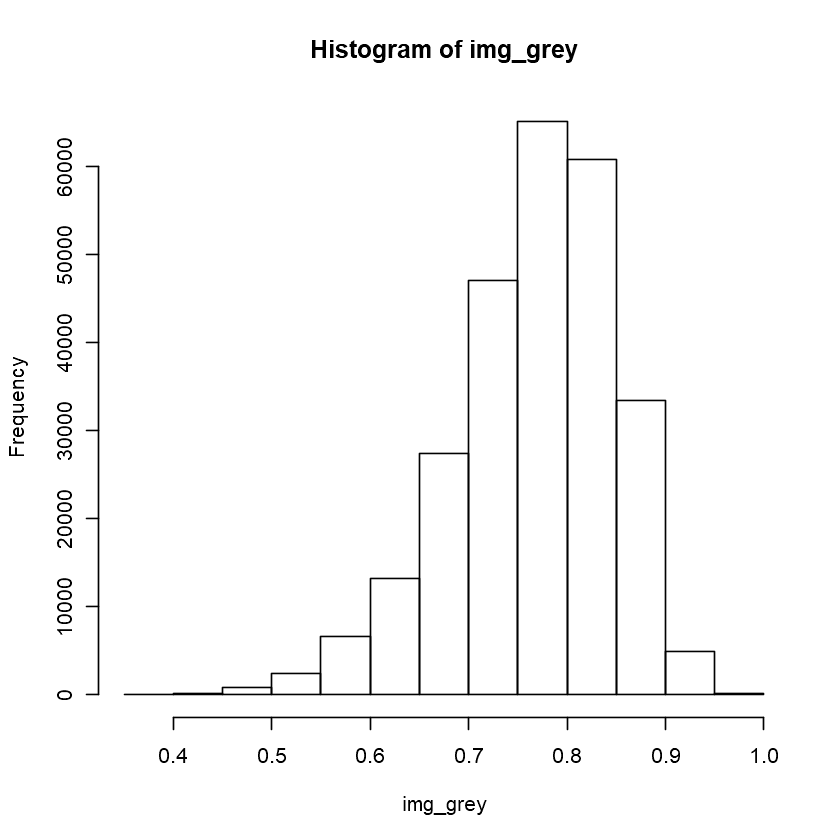

In [7]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric1_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

The greyscale image is obtained. In order to understand further the image pixel data, histogram and structure of the images are shown.

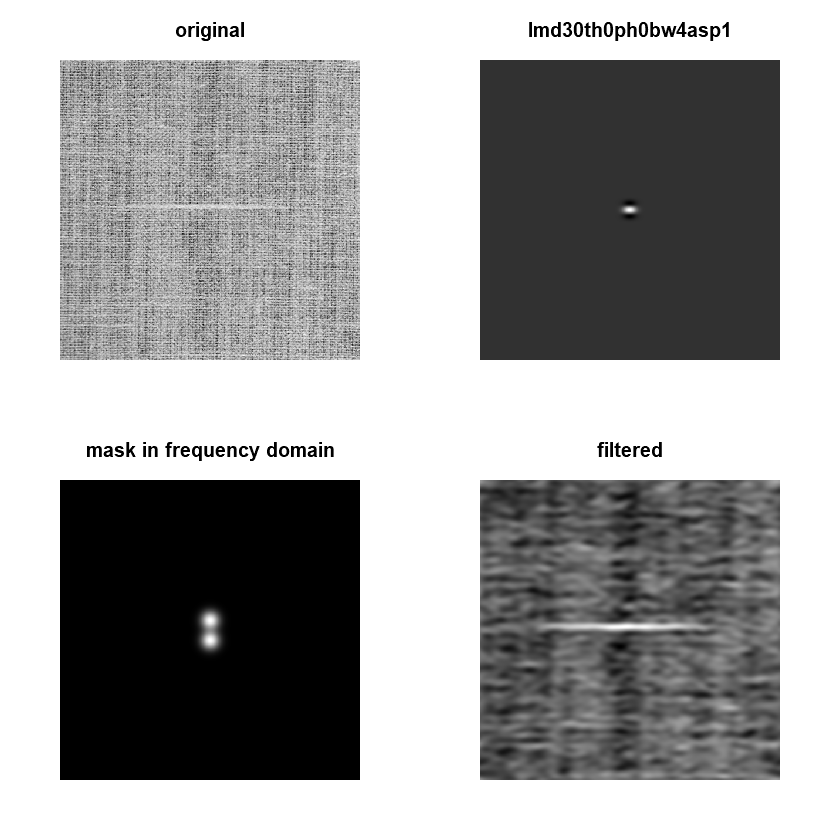

In [8]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

Gabor filter is applied to the image by using the parameters lamda=30, theta=0, bandwidth=4, phi=0 and asp=1. The results are displayed. The filtered image can be seen in the lower right side above. By the Gabor filter, the defect became more obvious and easier to detect.

In [9]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 21811667 21888951 21909784 21877731 21799296 ...


After checking the structure of the new image, it can be said that the Gabor filter is changing the values of the image matrix. The pixel values are no longer between 0 and 1. Then, the new image with Gabor filter is saved as "newimage" for further use.

In [10]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

X-bar chart is used to detect the defects in the images. To apply x-bar chart, at first, the image is seperated into 256 patches with 32x32 size to make the defect detection process more sensitive. Different number of patches with different sizes can be applied also, but for this time, the project will continue with this specifically defines patch number.
The mean values of every patch are collected in array "m" and standard deviations of them also collected in array "s".

In [11]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

While obtaining the x-bar chart, "m" values are used. Center Line is defined by the mean of the means of patches by taking the mean of array "m". Upper Control Limit is found by adding the Center Line 2 standard deviations of the mean array by taking the standard deviation of array "s". Similarly, Lower Control Limit is found by reducing 2 standard deviations of the mean array by taking the standard deviation of array "s" from the Center Line.

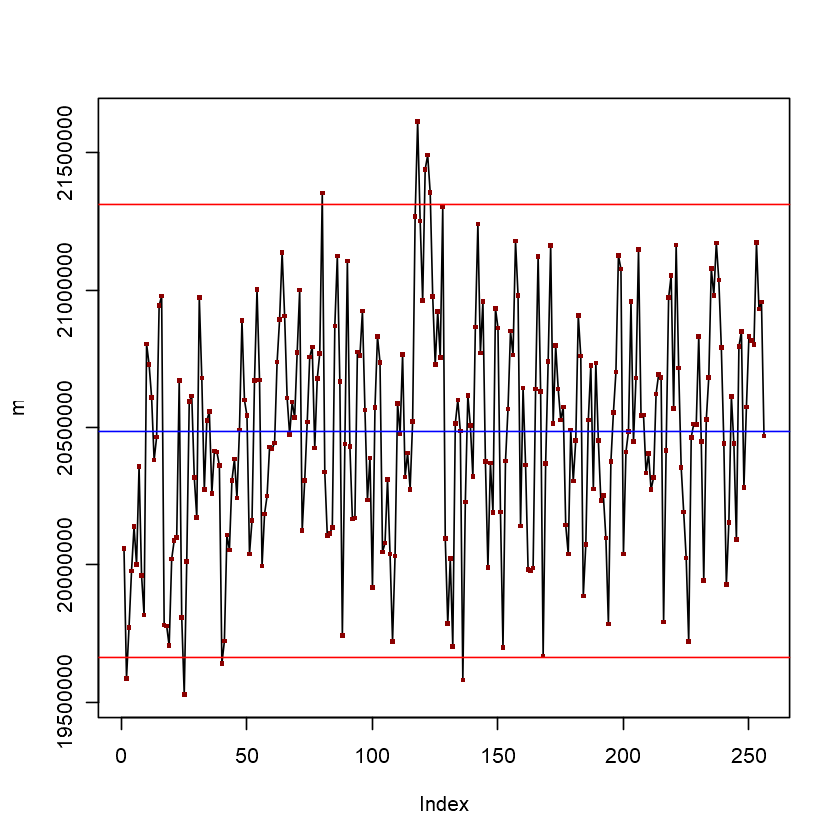

In [12]:
plot(m, type="l", lwd=1)
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

The x-bar chart is plotted above. Blue line reflects to the Center Line while red lines are the Control Limits. As it can be seen, some points are out of the control limits, indicating that they correspond to the defected patches.

In [13]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]   2  25  40  80 118 121 122 123 136

The indices of the patches which are out ouf the control limits are found.

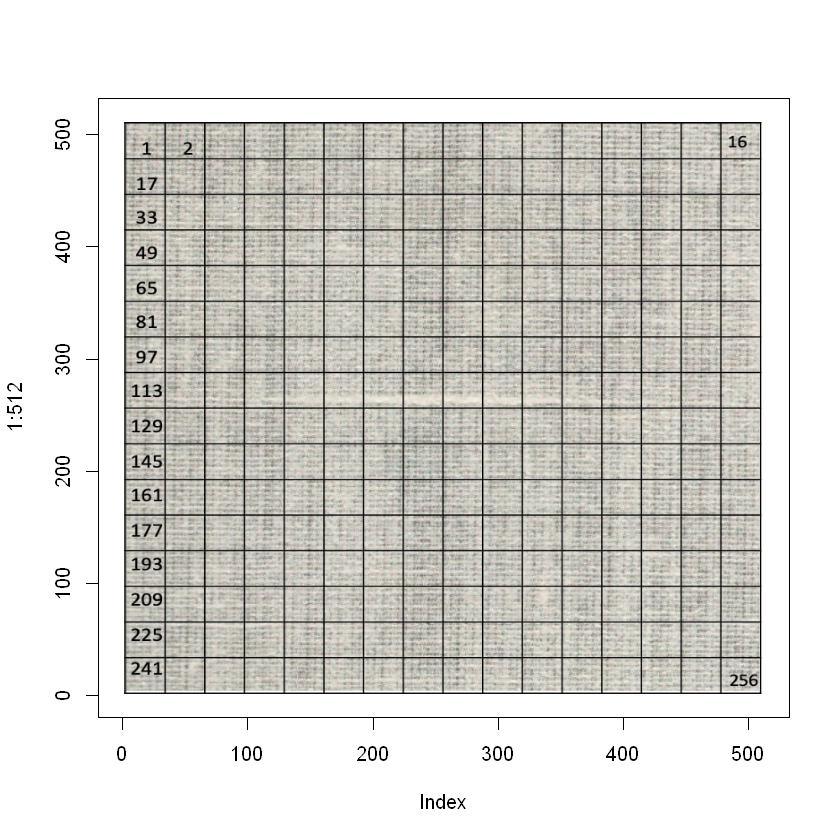

In [2]:
library(jpeg)
img_original1<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid1.jpg")
plot(1:512, type='n')
rasterImage(img_original1, 1, 1, 512, 512)

The out of control patches can be located in the image by using the gridlines and indices given above. For this paticular linen image 118, 121, 122 and 123 are out of control patches which are matching the defected parts of the linen can be seen with bare eye also.

### A.2. Fabric2

 num [1:512, 1:512] 0.612 0.451 0.455 0.522 0.608 ...


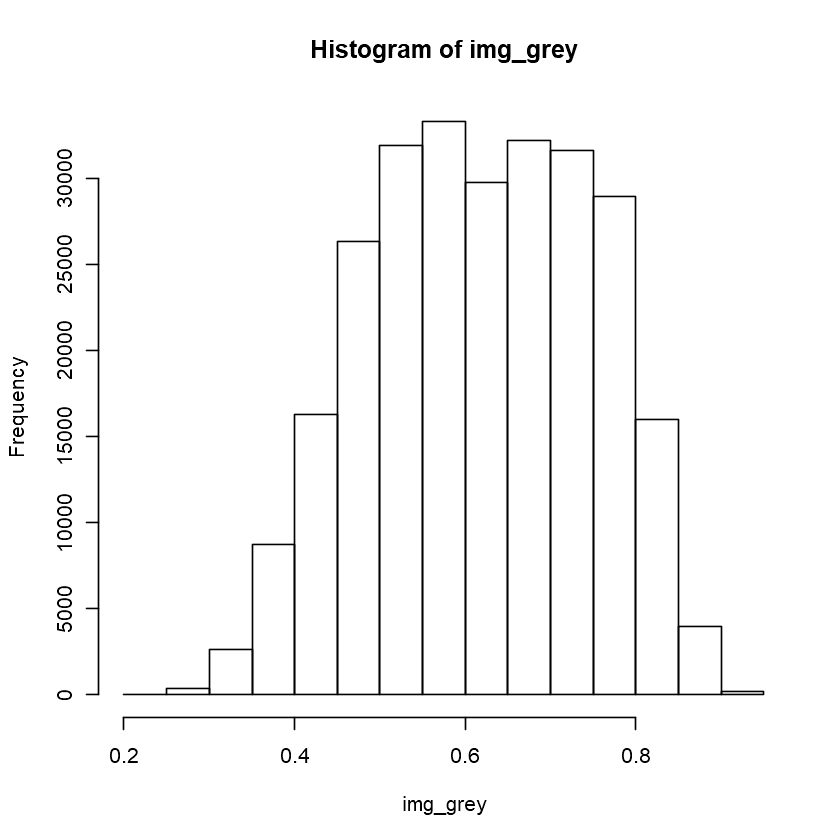

In [14]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric2_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

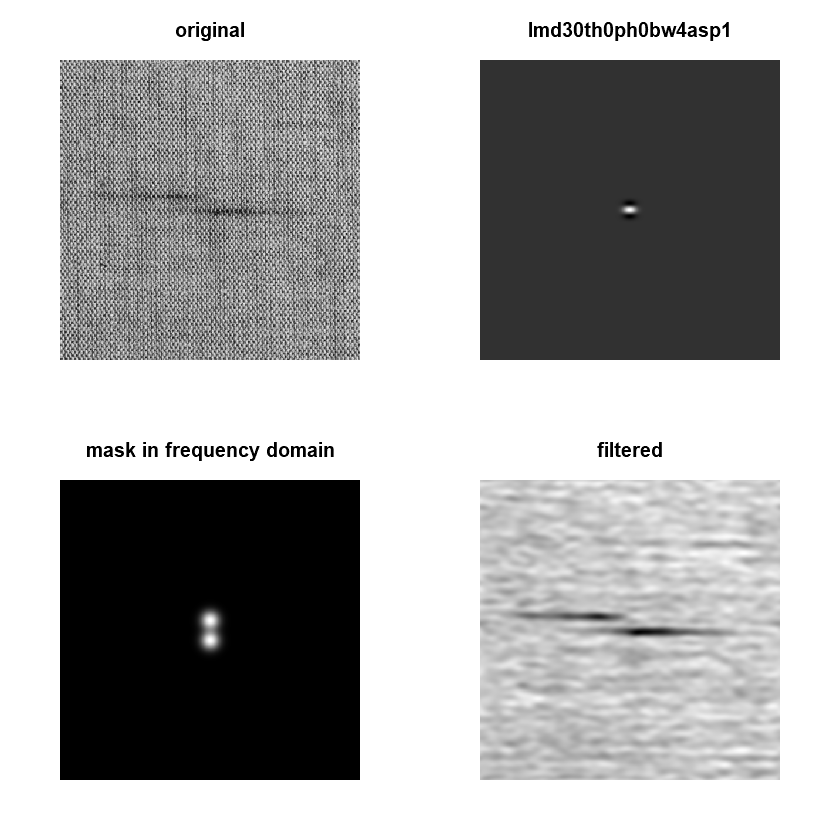

In [15]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

In [16]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 16424555 16578320 16762269 16957913 17144448 ...


In [17]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [18]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

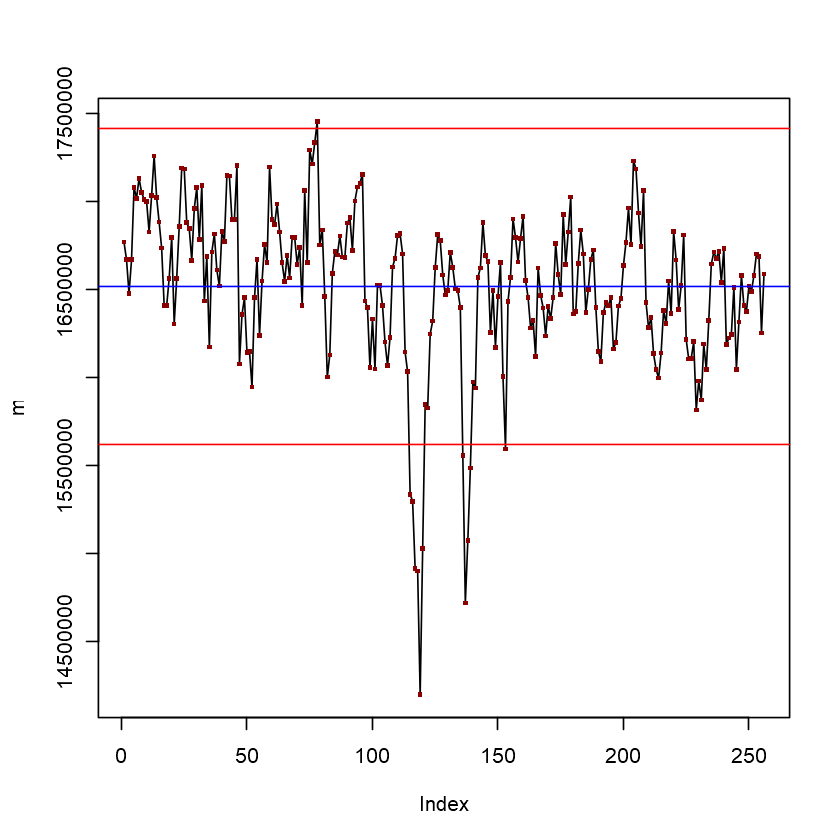

In [19]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [20]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]  78 115 116 117 118 119 120 136 137 138 139 153

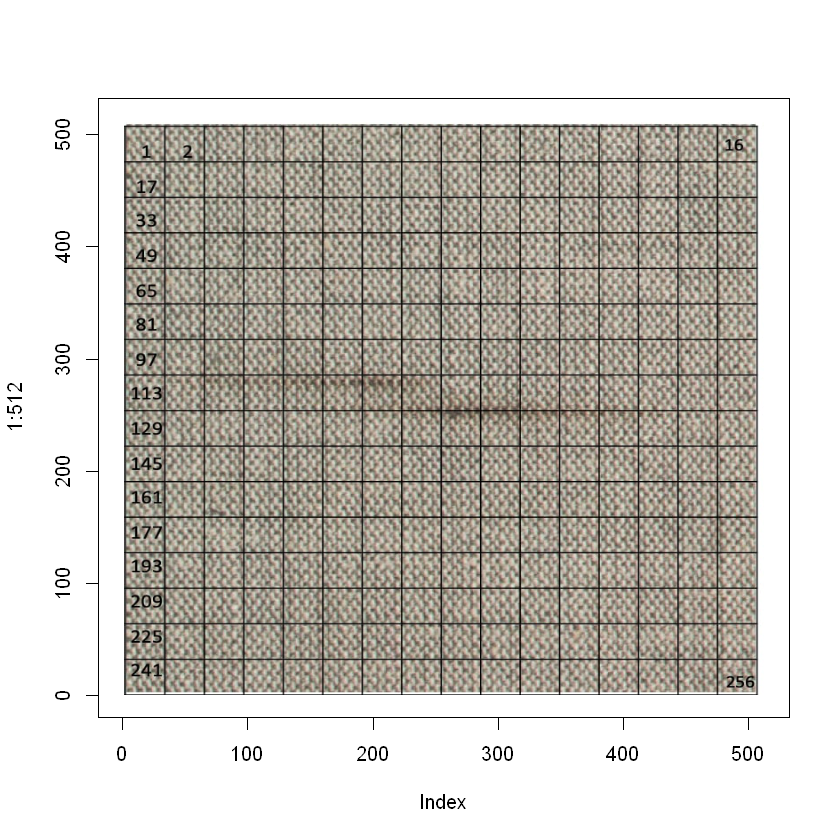

In [3]:
img_original2<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid2.jpg")
plot(1:512, type='n')
rasterImage(img_original2, 1, 1, 512, 512)

### A.3. Fabric4

 num [1:512, 1:512] 0.769 0.808 0.804 0.78 0.784 ...


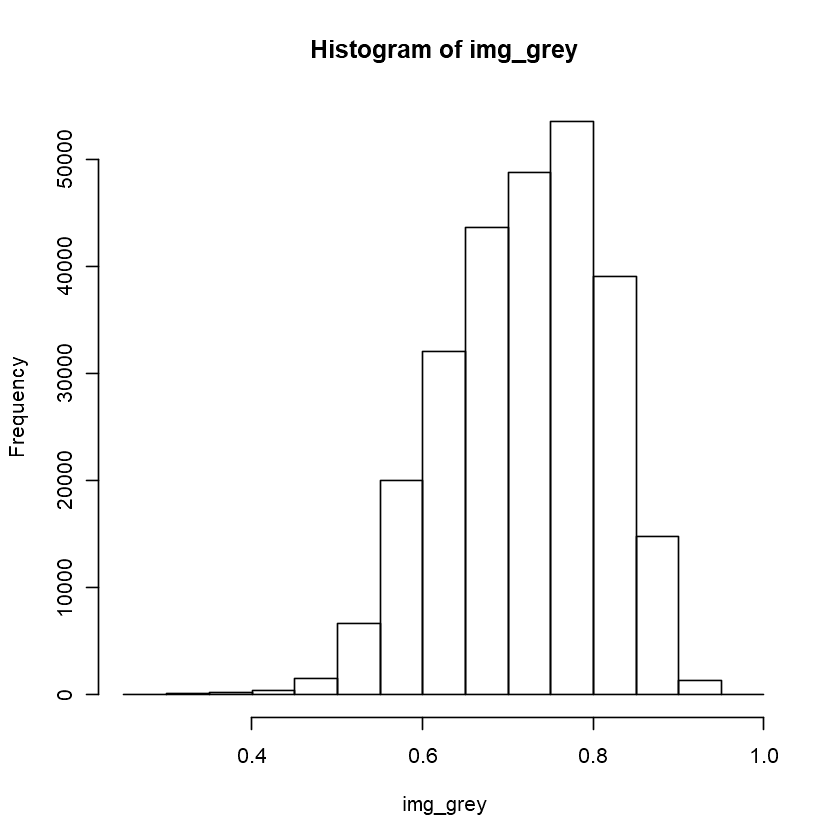

In [21]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric4_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

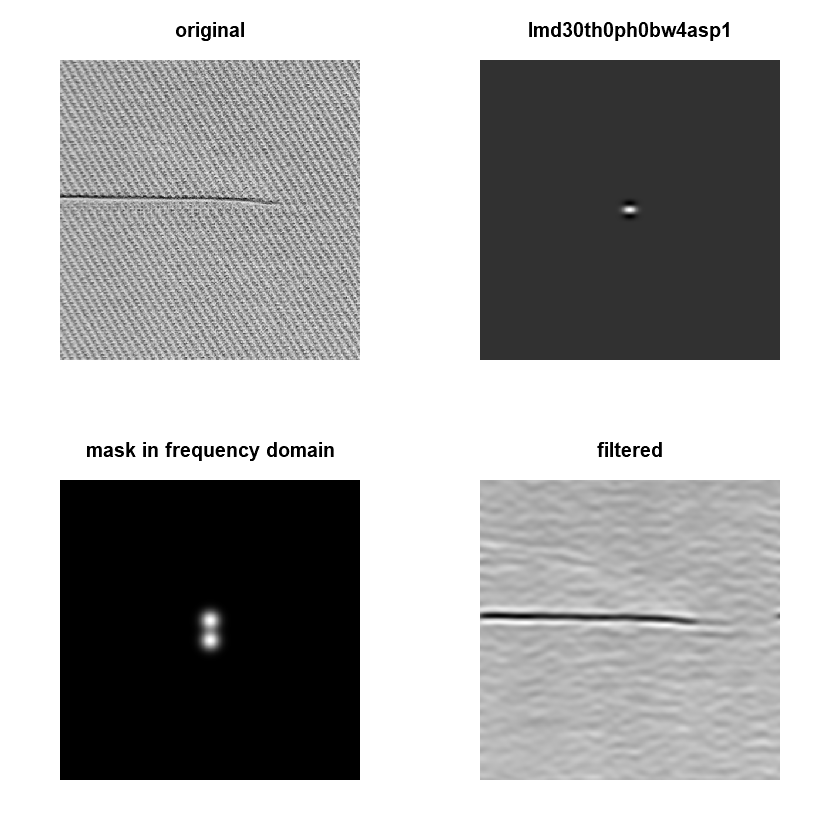

In [22]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

In [23]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 18977964 18941881 18927930 18932781 18952109 ...


In [24]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [25]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

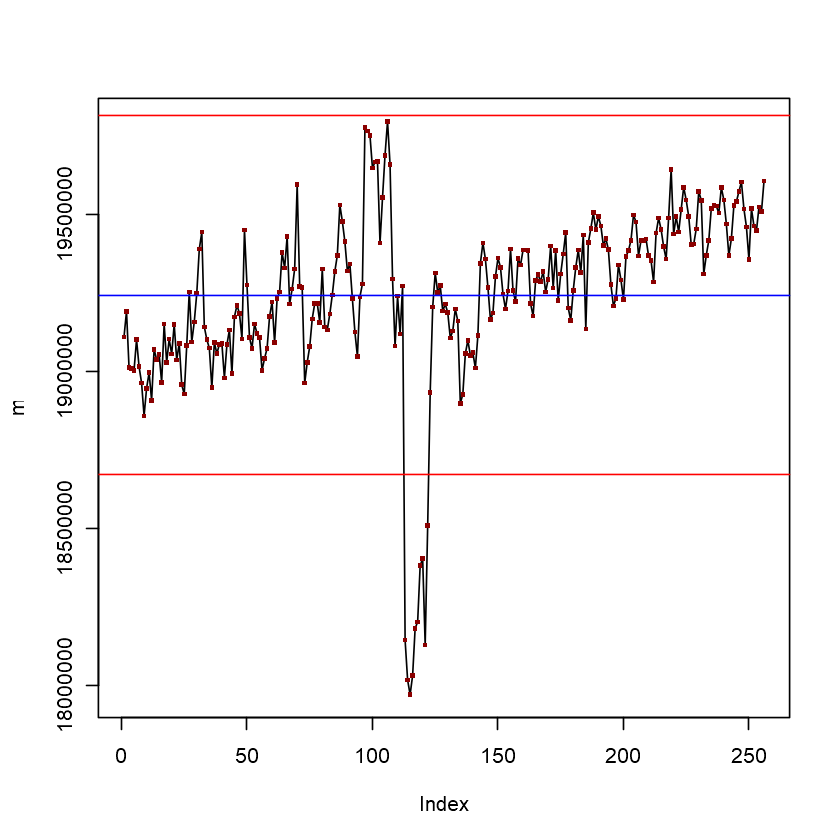

In [26]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [27]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 113 114 115 116 117 118 119 120 121 122

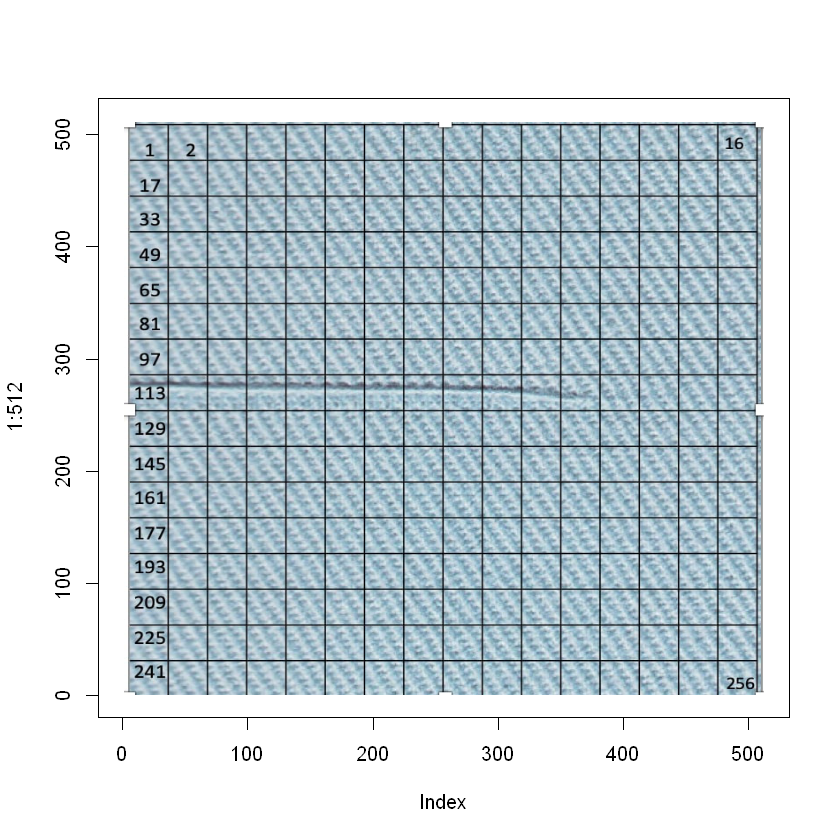

In [4]:
img_original4<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid4.jpg")
plot(1:512, type='n')
rasterImage(img_original4, 1, 1, 512, 512)

### A.4. Fabric11

 num [1:512, 1:512] 0.682 0.576 0.639 0.694 0.8 ...


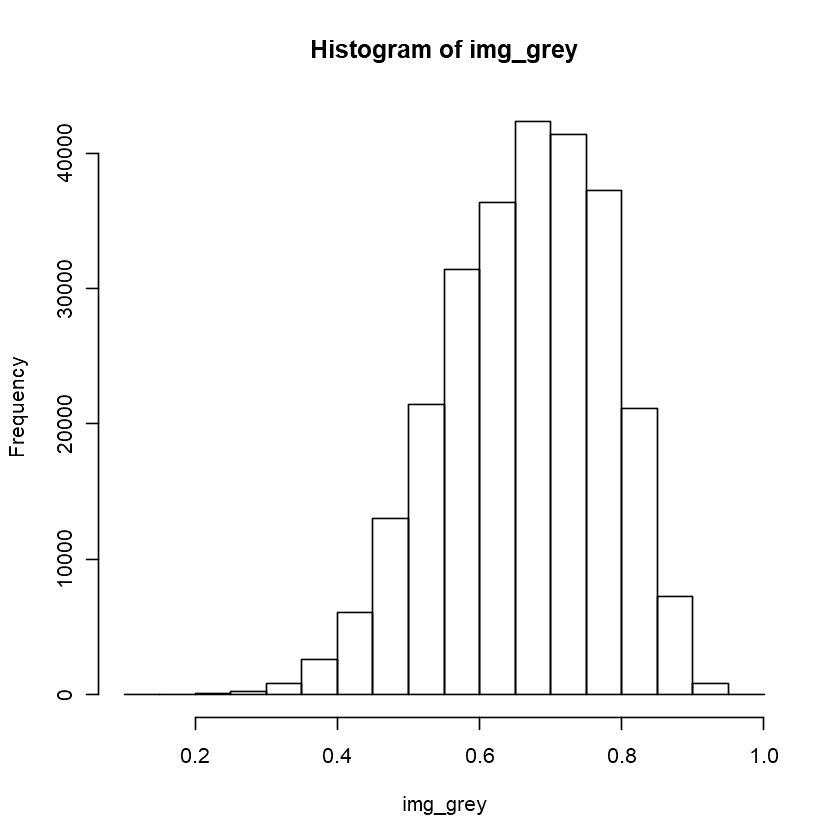

In [28]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric11_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

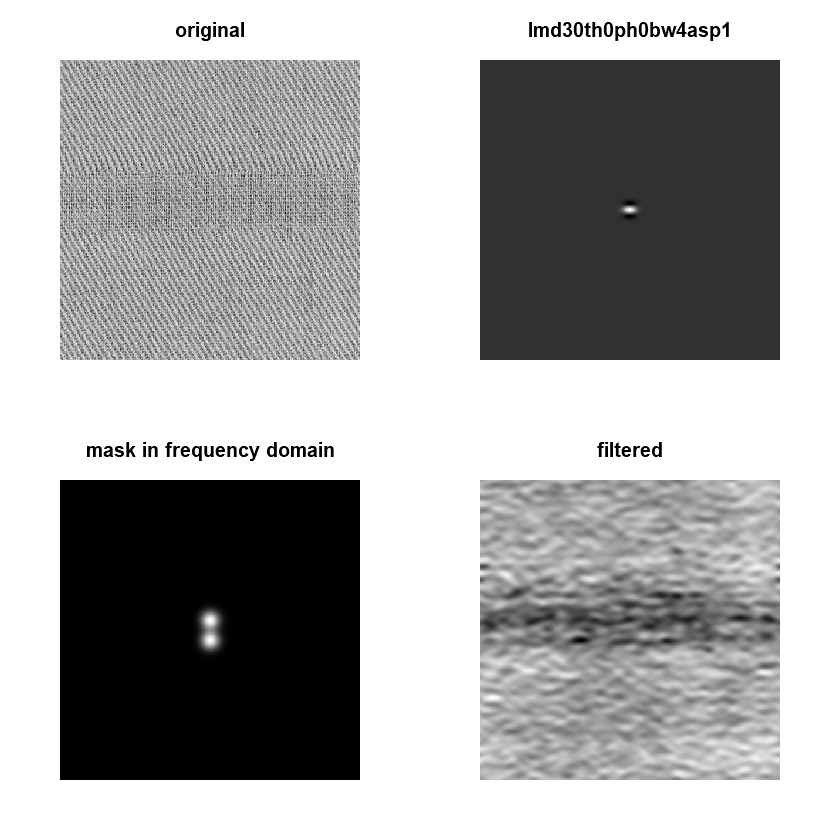

In [29]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

In [30]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 17744601 17781796 17823785 17865336 17901707 ...


In [31]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [32]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

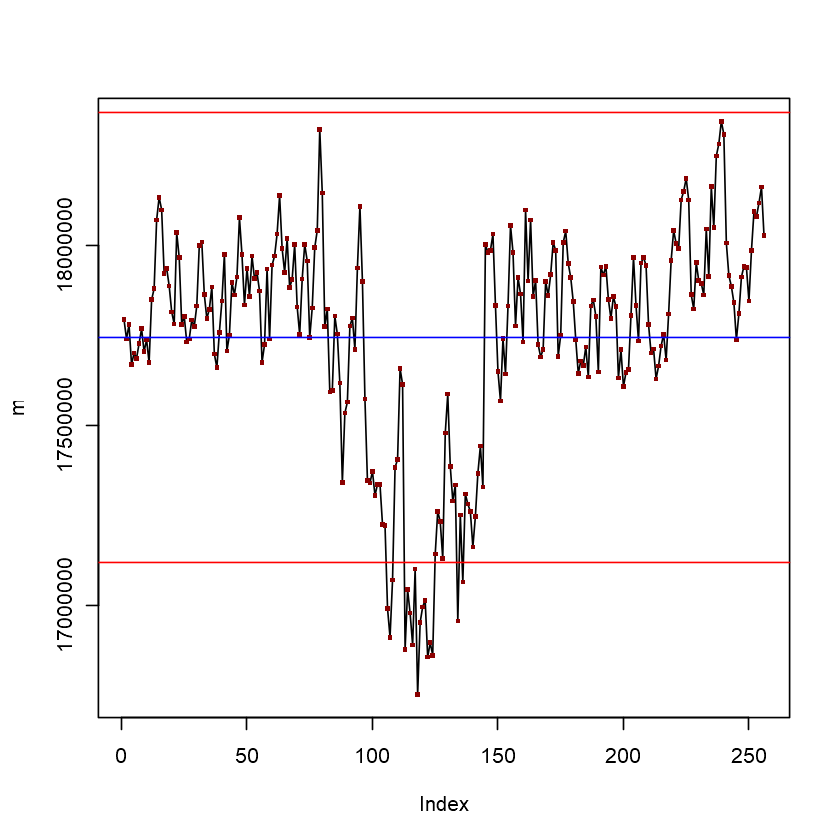

In [33]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [34]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 106 107 108 113 114 115 116 117 118 119 120 121 122 123 124 134 136

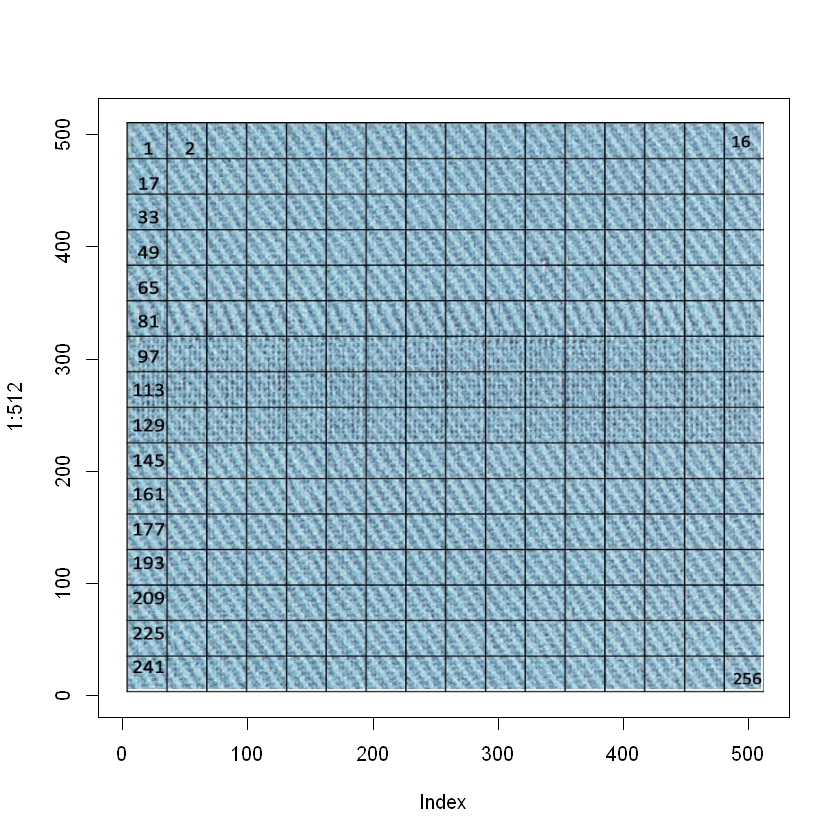

In [5]:
img_original11<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid11.jpg")
plot(1:512, type='n')
rasterImage(img_original11, 1, 1, 512, 512)

### A.5. Fabric12

 num [1:512, 1:512] 0.212 0.231 0.239 0.329 0.345 ...


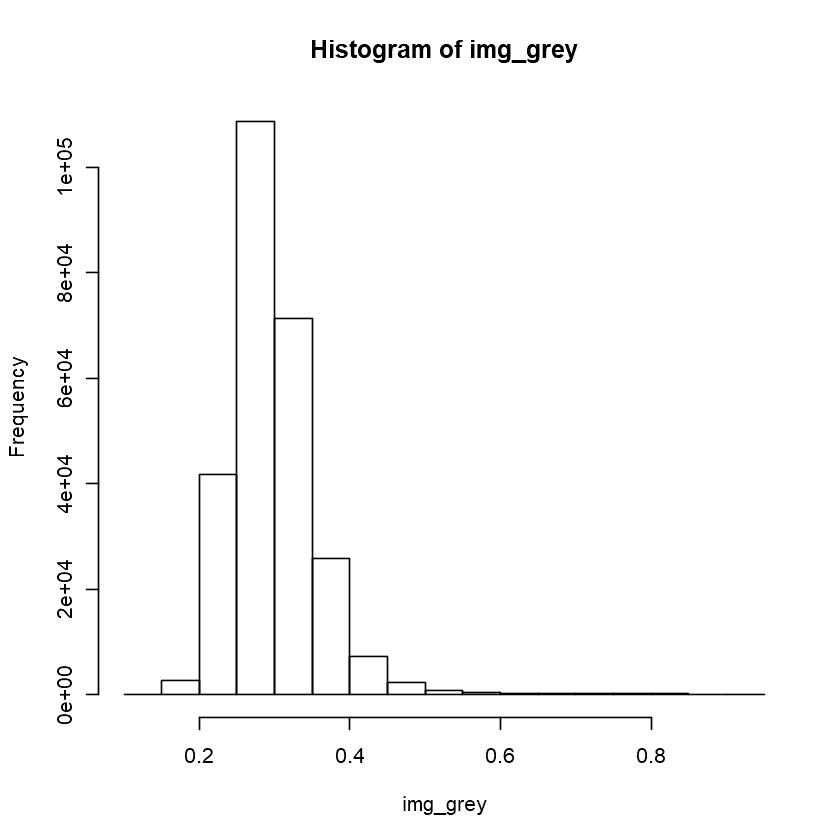

In [35]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric12_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

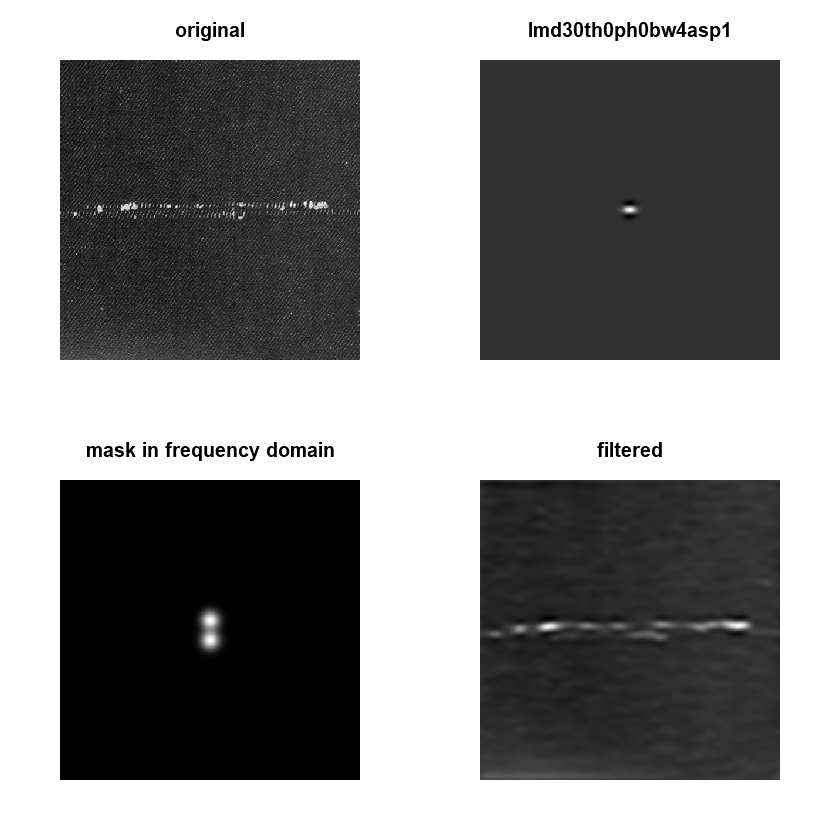

In [36]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

In [37]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 8853323 8524022 8202434 7910551 7667147 ...


In [38]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [39]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

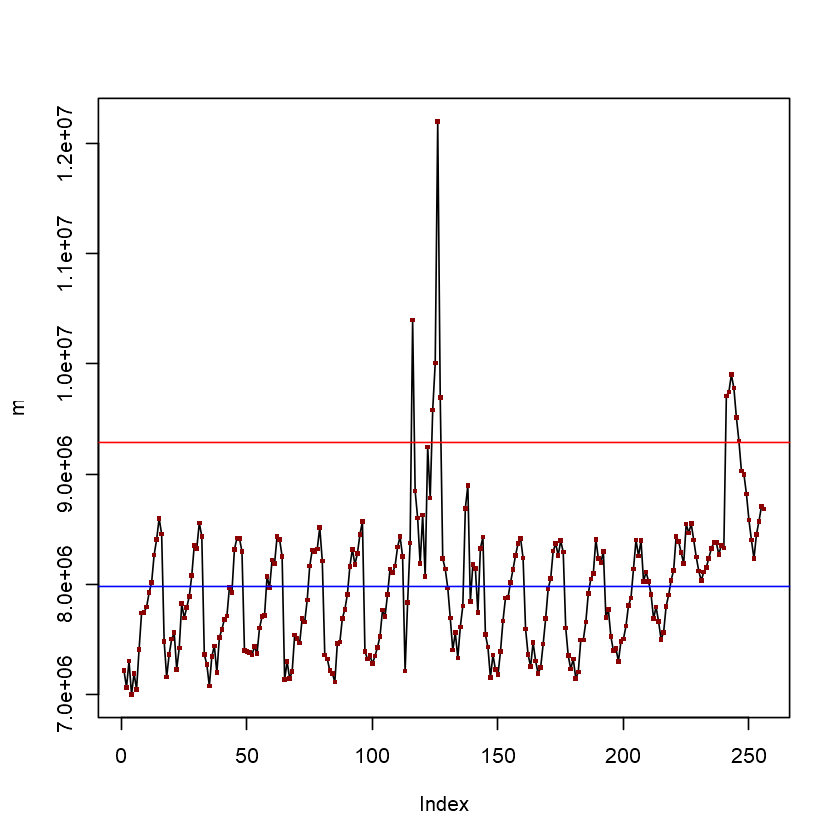

In [40]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [41]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 116 124 125 126 127 241 242 243 244 245 246

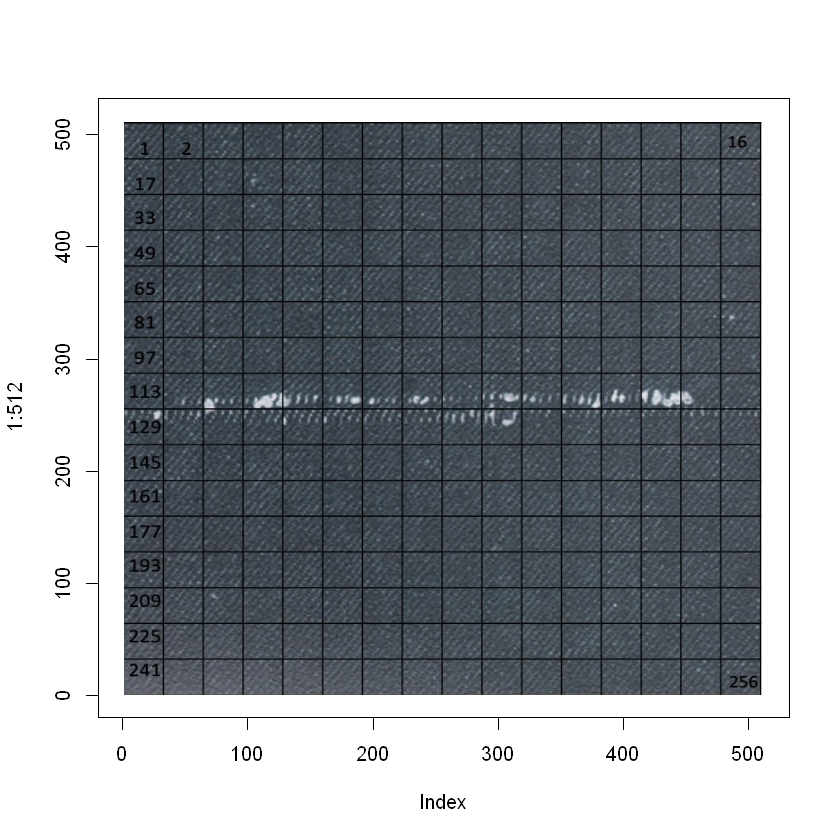

In [6]:
img_original12<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid12.jpg")
plot(1:512, type='n')
rasterImage(img_original12, 1, 1, 512, 512)

### A.6. Fabric13

 num [1:512, 1:512] 0.573 0.365 0.49 0.451 0.345 ...


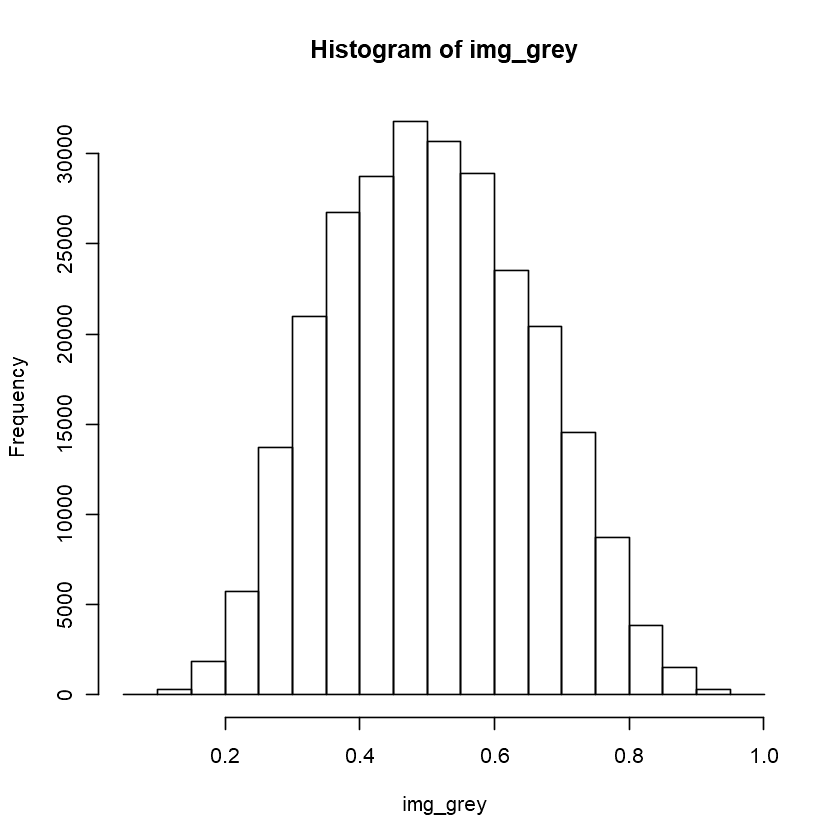

In [42]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric13_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

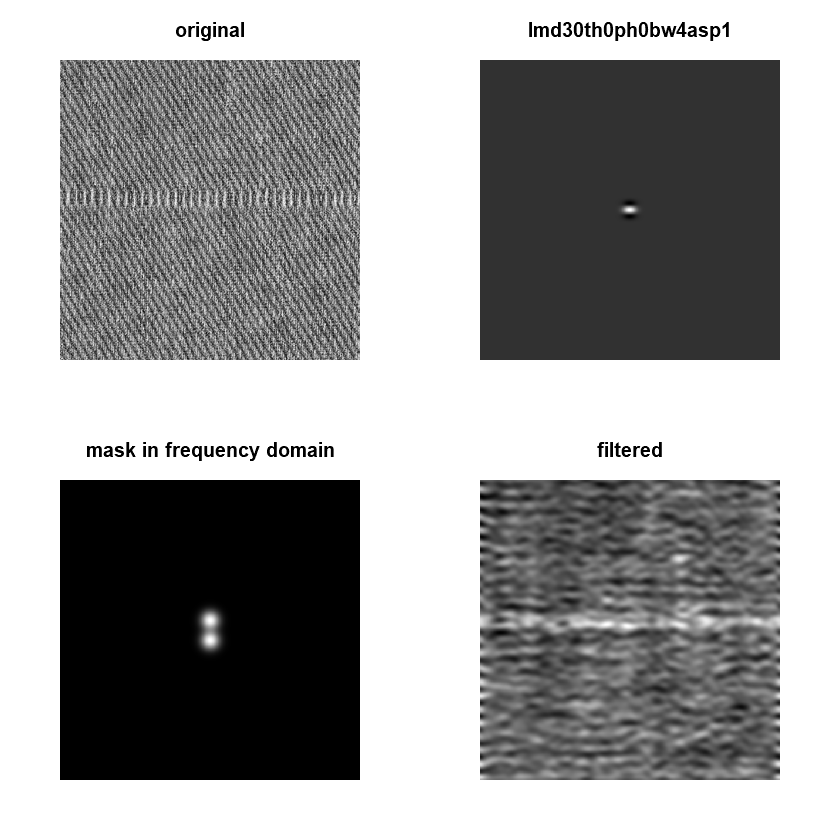

In [43]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

In [44]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 13790001 13211621 12700021 12301613 12050958 ...


In [45]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [46]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

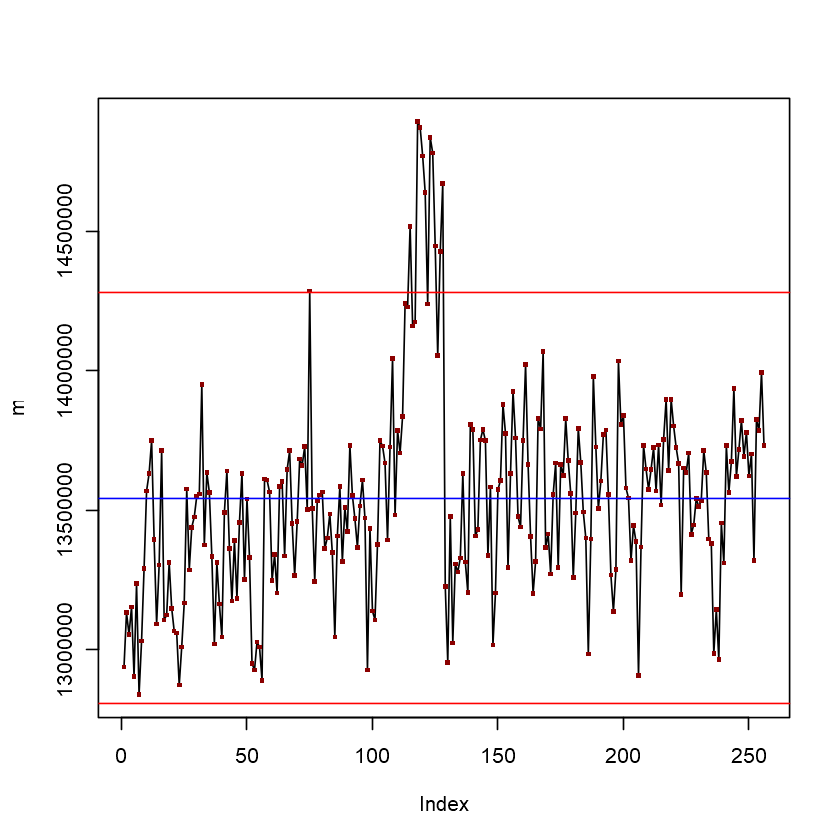

In [47]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [48]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]  75 115 118 119 120 121 123 124 125 127 128

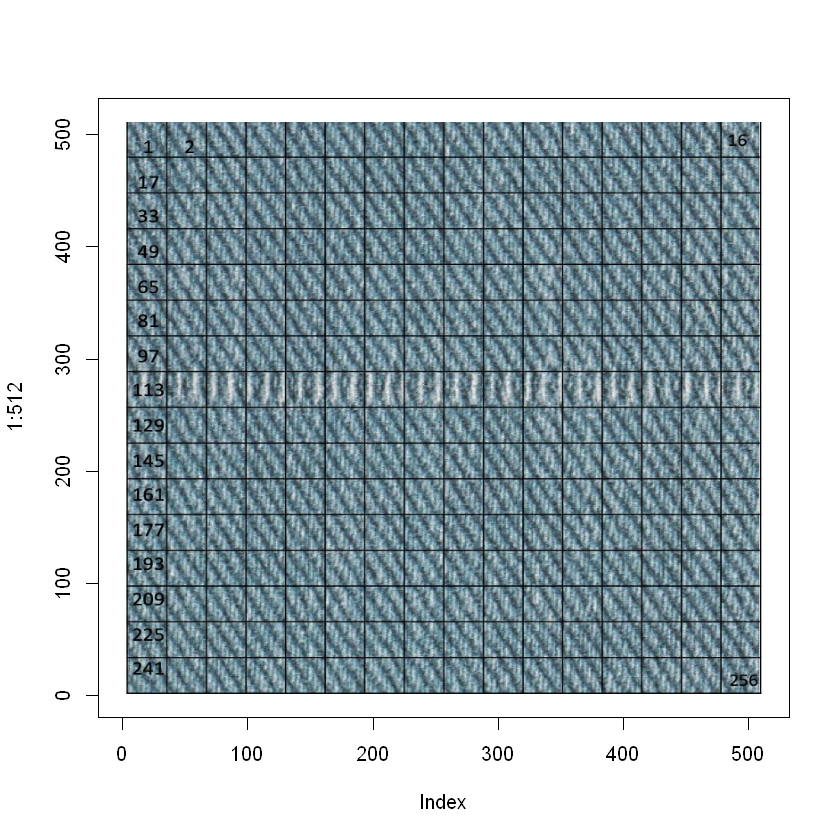

In [7]:
img_original13<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid13.jpg")
plot(1:512, type='n')
rasterImage(img_original13, 1, 1, 512, 512)

### A.7. Fabric14

 num [1:512, 1:512] 0.737 0.71 0.596 0.49 0.667 ...


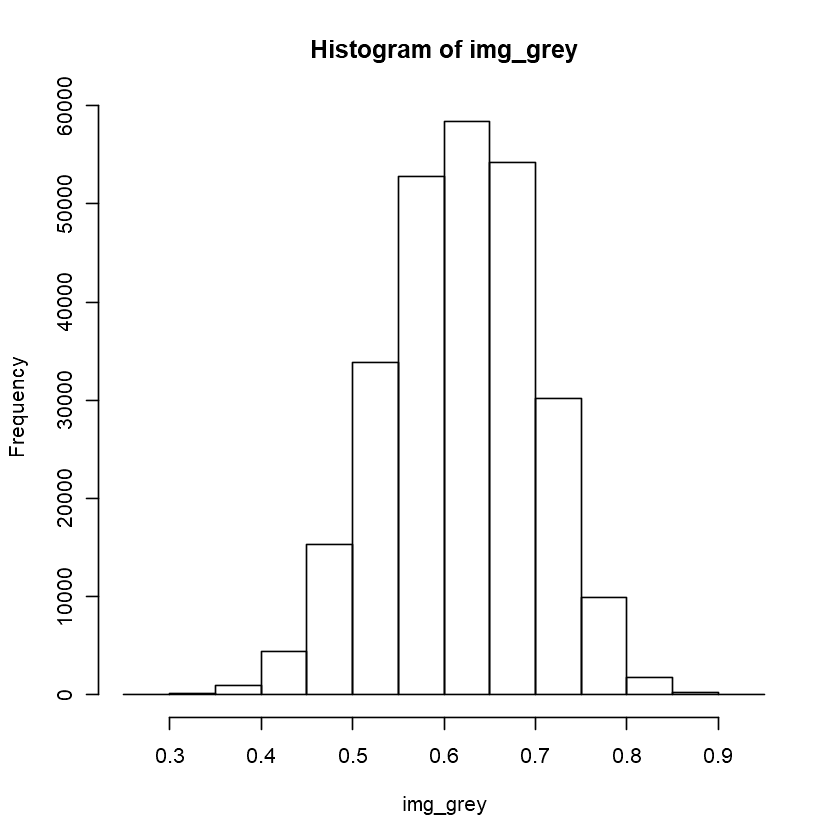

In [49]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/horizontal/Fabric14_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

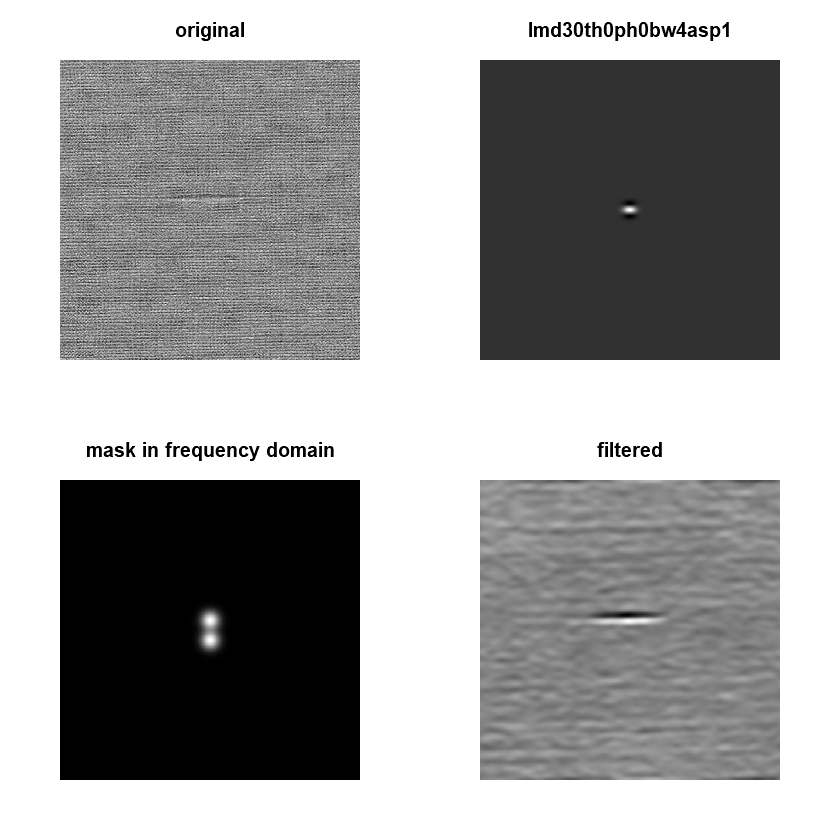

In [50]:
test<-gabor.filter(img_grey,30,0,4,0,1,TRUE)

In [51]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 16357517 16401998 16447665 16493401 16538200 ...


In [52]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [53]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

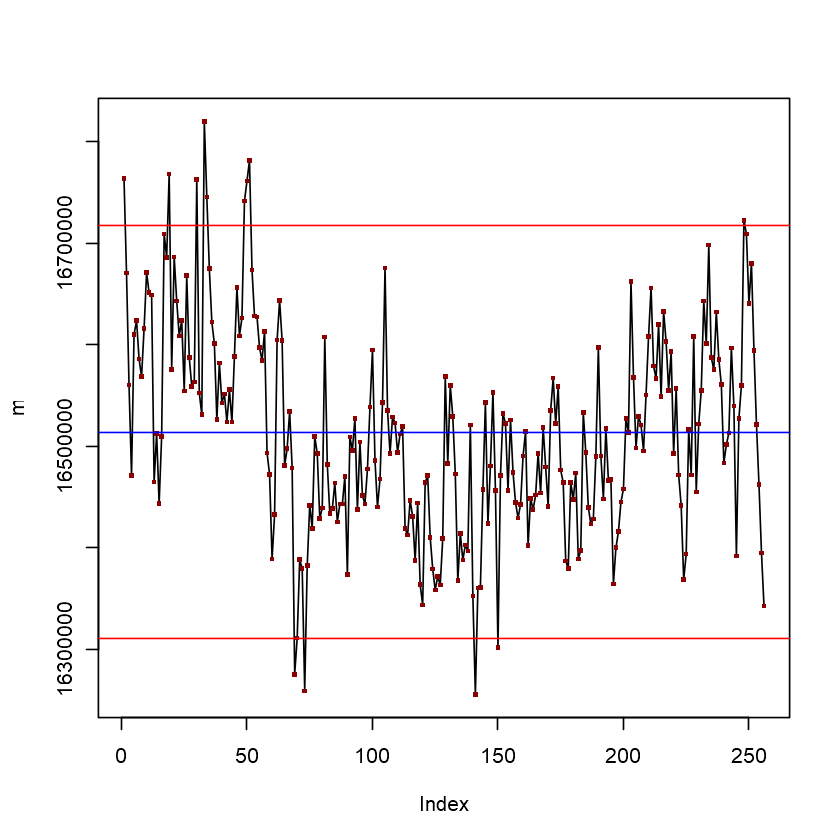

In [54]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [55]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]   1  19  30  33  34  49  50  51  69  73 141 150 248

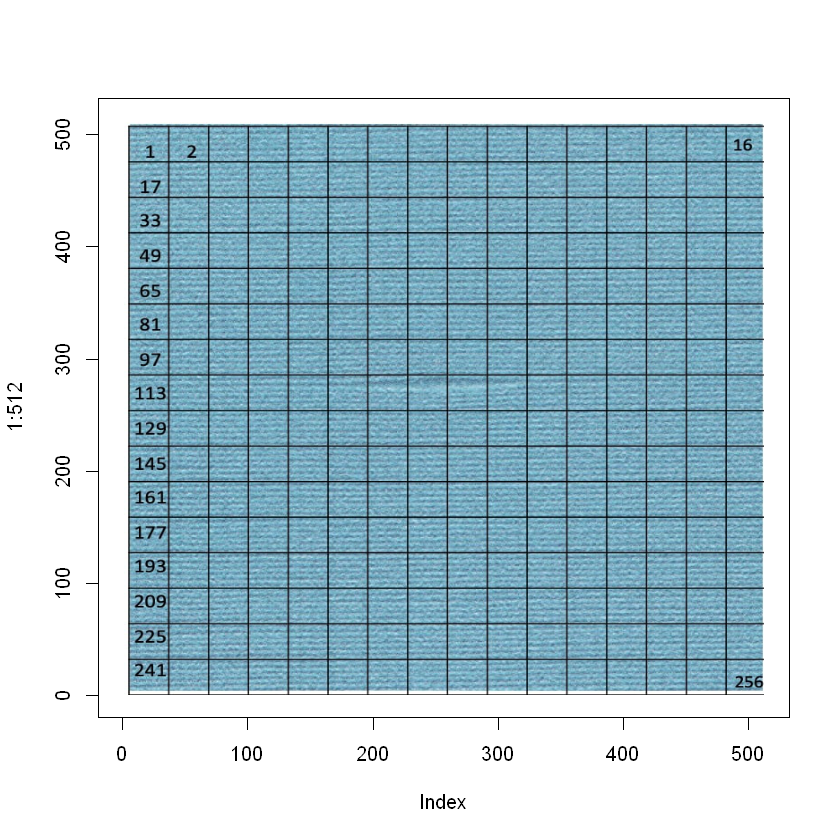

In [8]:
img_original14<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid14.jpg")
plot(1:512, type='n')
rasterImage(img_original14, 1, 1, 512, 512)

### B. Vertically Defected Linen Images

In this part, 9 vertically defected linen images are investigated by taking the orientation which is theta as 90° as a parameter of Gabor filter function different from the Horizontally Defected Linen Images.

### B.1. Fabric5

 num [1:512, 1:512] 0.529 0.467 0.612 0.518 0.353 ...


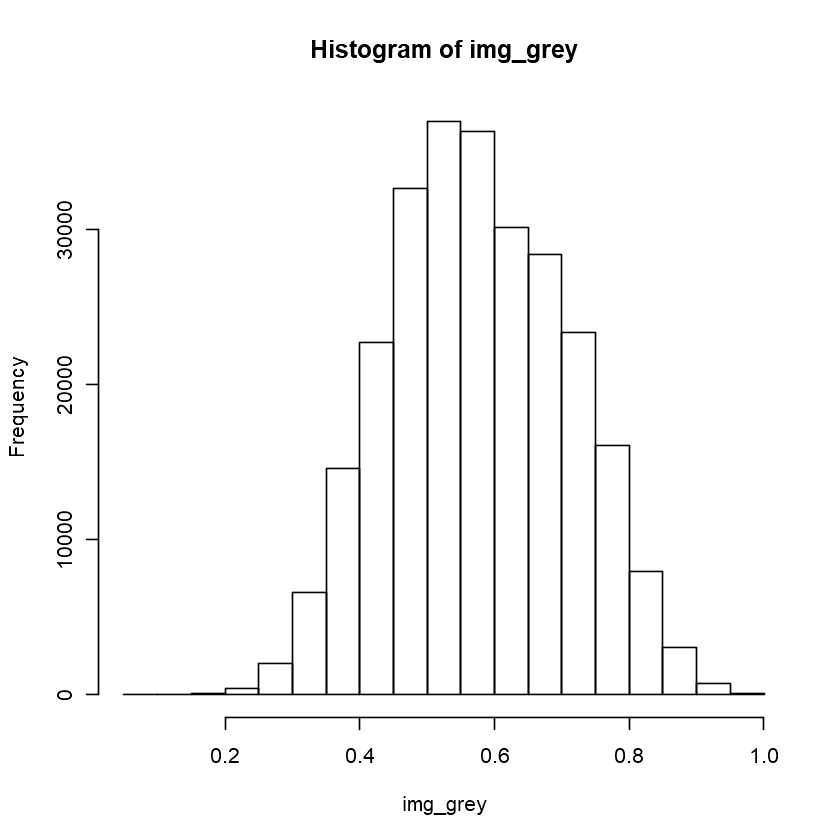

In [56]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric5_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

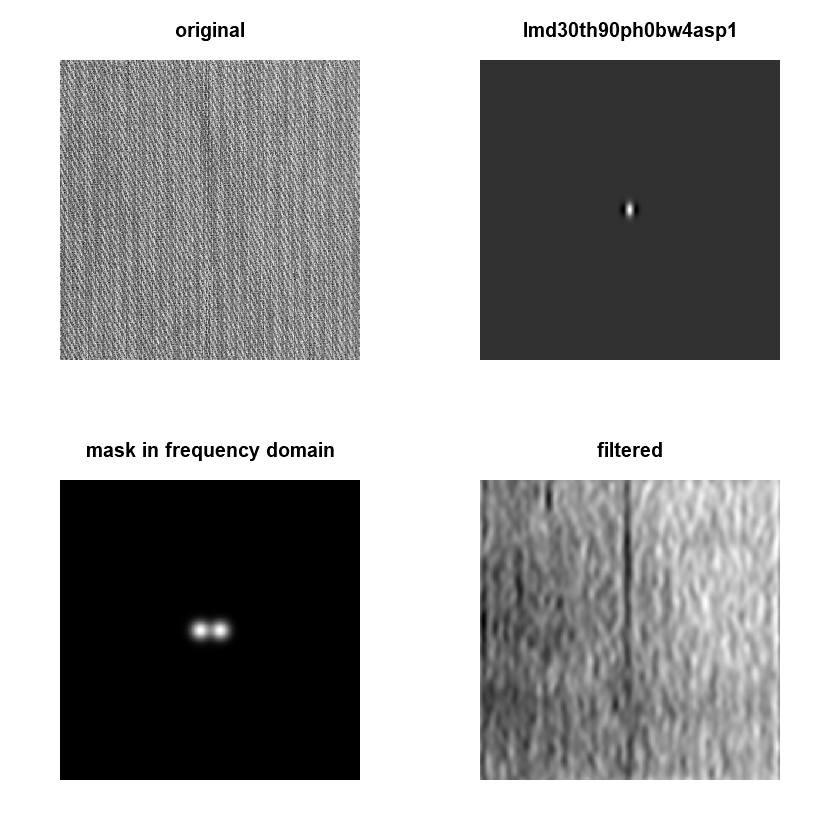

In [57]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

Gabor filter is applied to the image by using the parameters lamda=30, theta=90, bandwidth=4, phi=0 and asp=1 which means that the only difference between horizontal and vertical defects is that their orientation angle which is 90° in vertical defect case. The results are displayed. The filtered image can be seen in the lower right side above. By the Gabor filter, the defect became more obvious and easier to detect.

In [58]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 15532010 15564679 15595423 15624088 15650594 ...


In [59]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [60]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

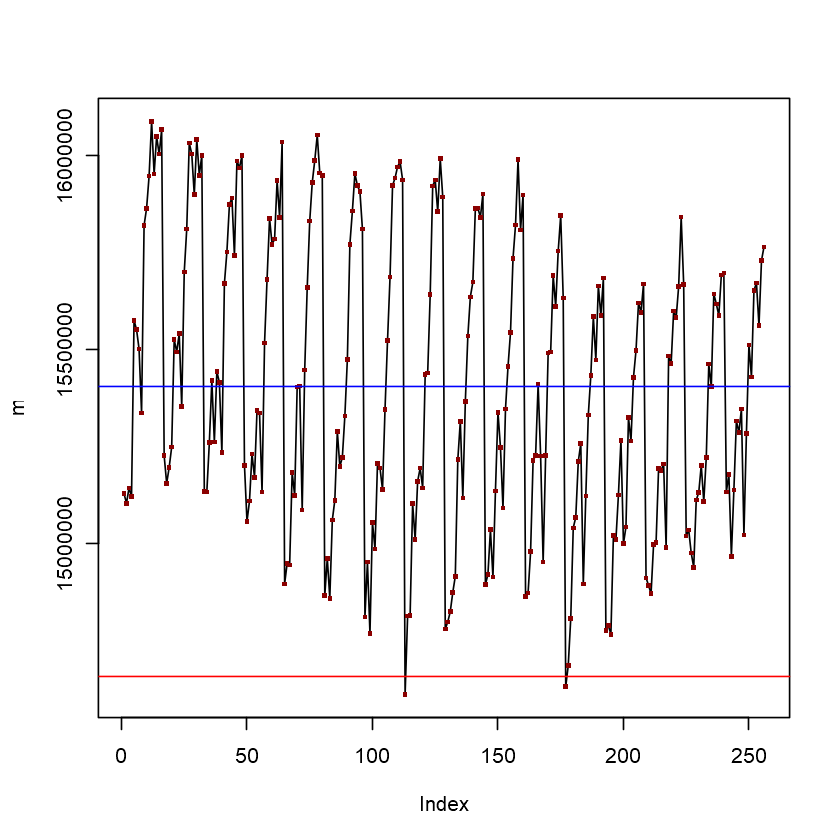

In [61]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [62]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 113 177

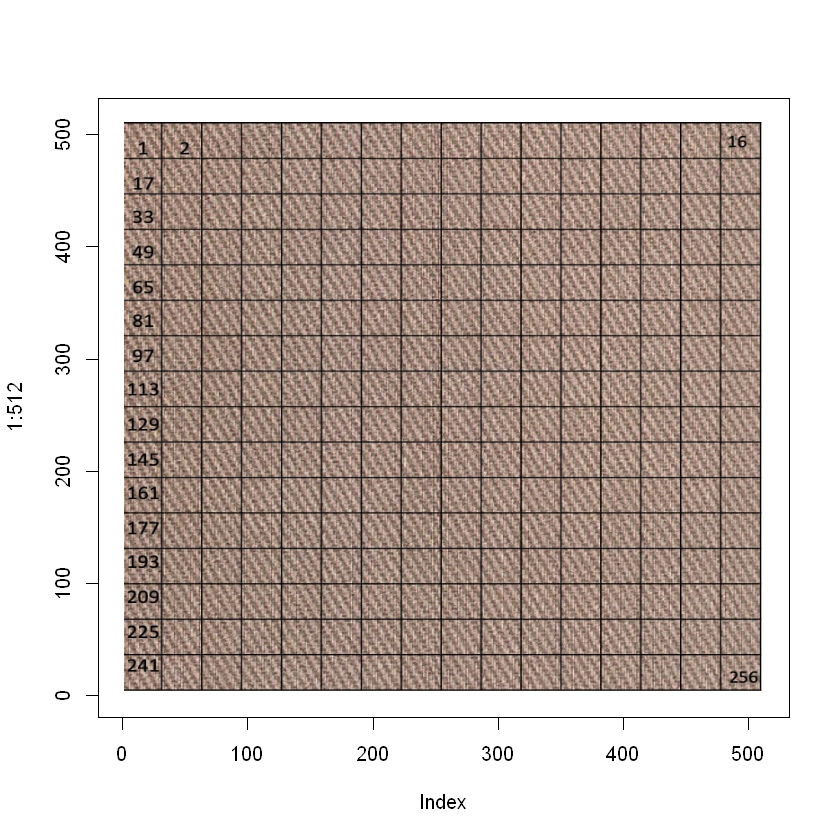

In [9]:
img_original5<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid5.jpg")
plot(1:512, type='n')
rasterImage(img_original5, 1, 1, 512, 512)

### B.2. Fabric6

 num [1:512, 1:512] 0.353 0.231 0.278 0.341 0.314 ...


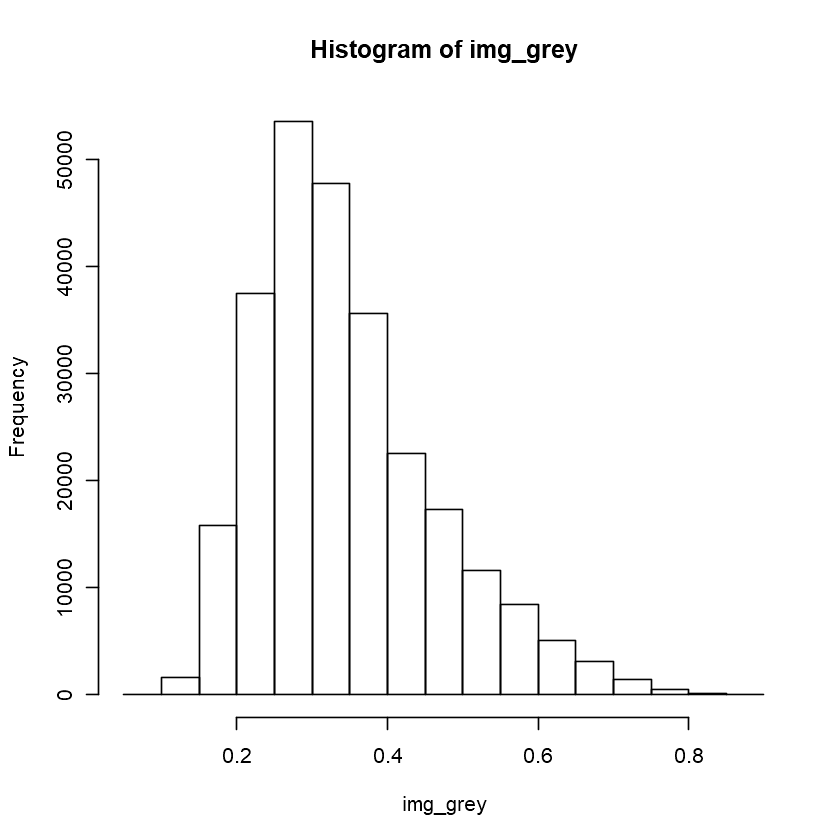

In [63]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric6_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

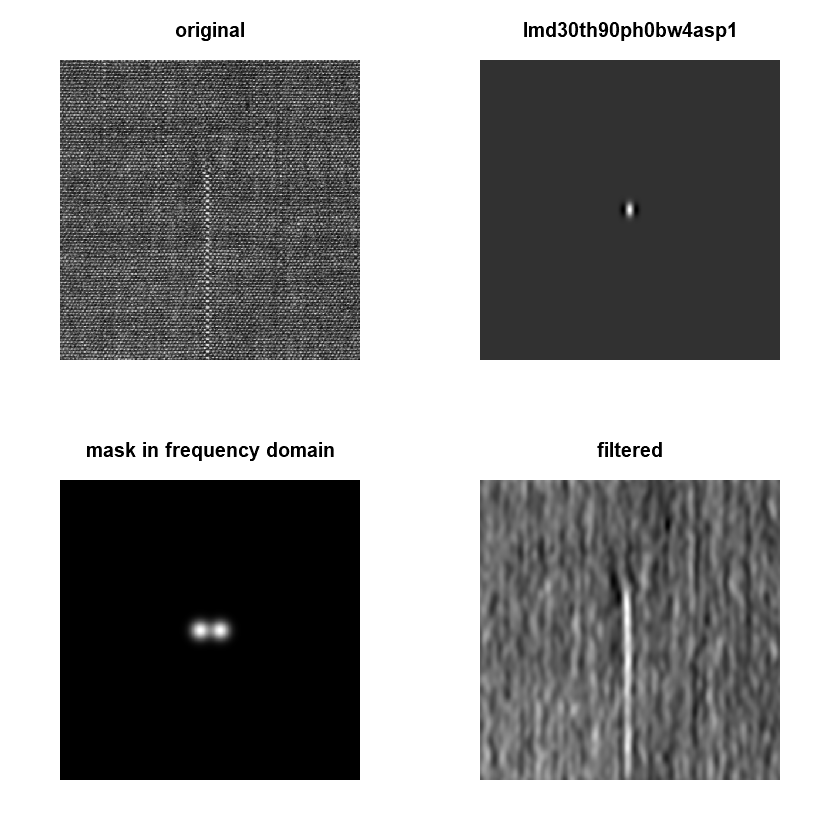

In [64]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [65]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 8701514 8706418 8727320 8762669 8810206 ...


In [66]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [67]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

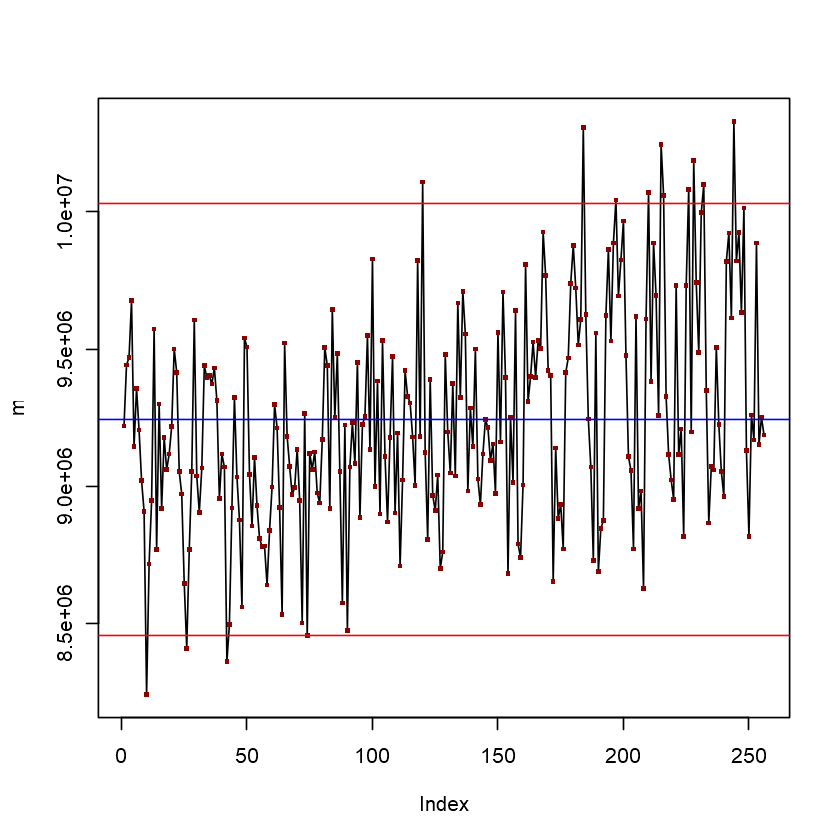

In [68]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [69]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]  10  26  42  74 120 184 197 210 215 216 226 228 232 244

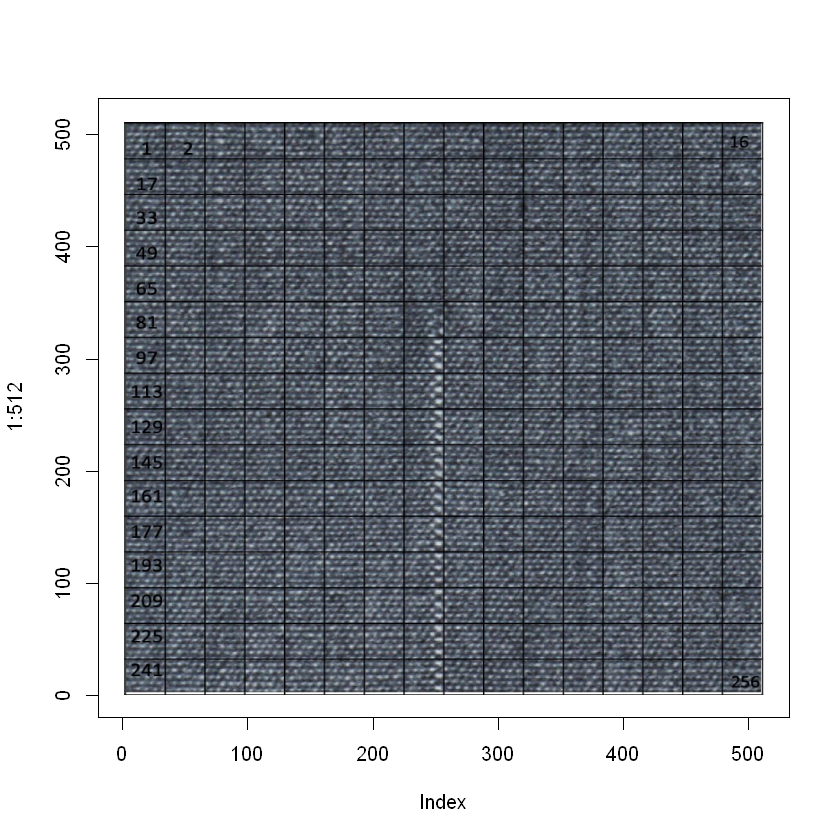

In [10]:
img_original6<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid6.jpg")
plot(1:512, type='n')
rasterImage(img_original6, 1, 1, 512, 512)

### B.3. Fabric7

 num [1:512, 1:512] 0.424 0.38 0.408 0.549 0.231 ...


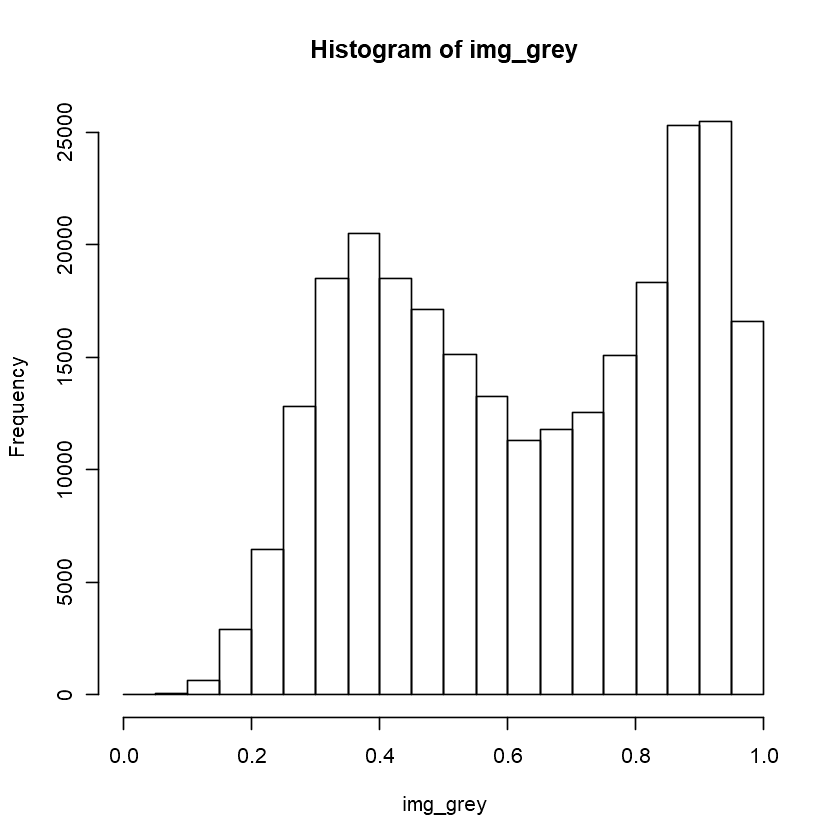

In [70]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric7_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

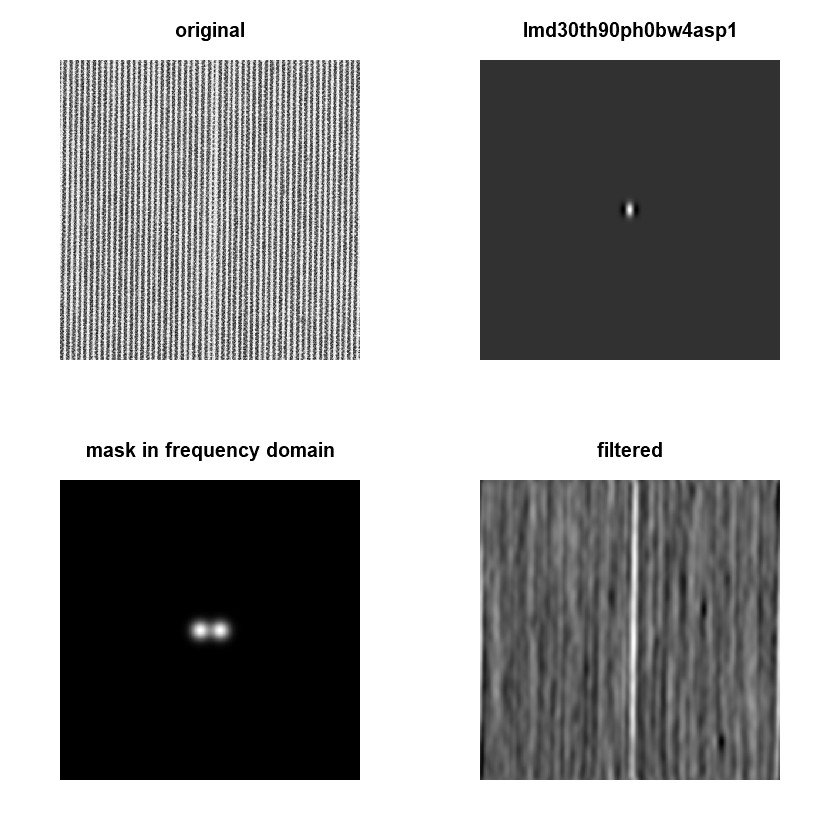

In [71]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [72]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 14796129 14808407 14813550 14811391 14802110 ...


In [73]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [74]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

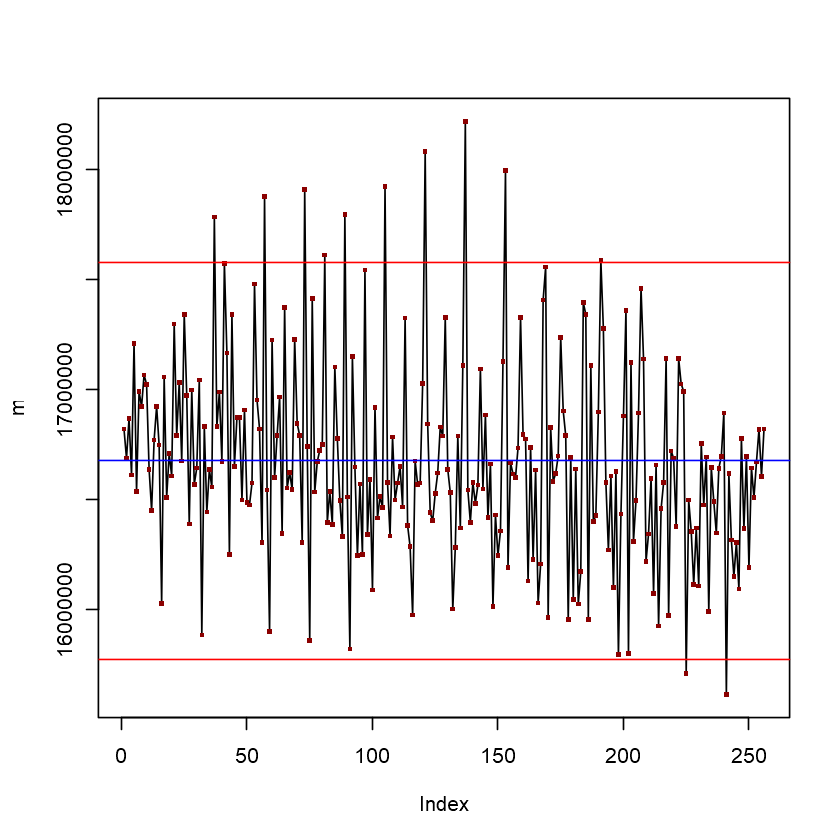

In [75]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [76]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]  37  57  73  81  89 105 121 137 153 191 225 241

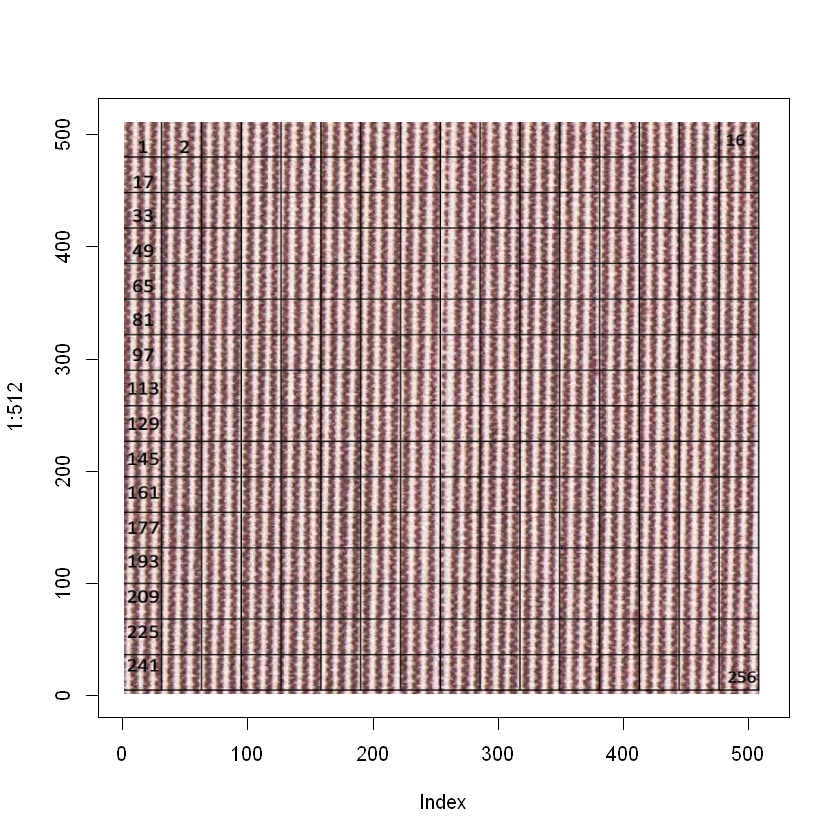

In [11]:
img_original7<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid7.jpg")
plot(1:512, type='n')
rasterImage(img_original7, 1, 1, 512, 512)

### B.4. Fabric8

 num [1:512, 1:512] 0.502 0.561 0.714 0.714 0.71 ...


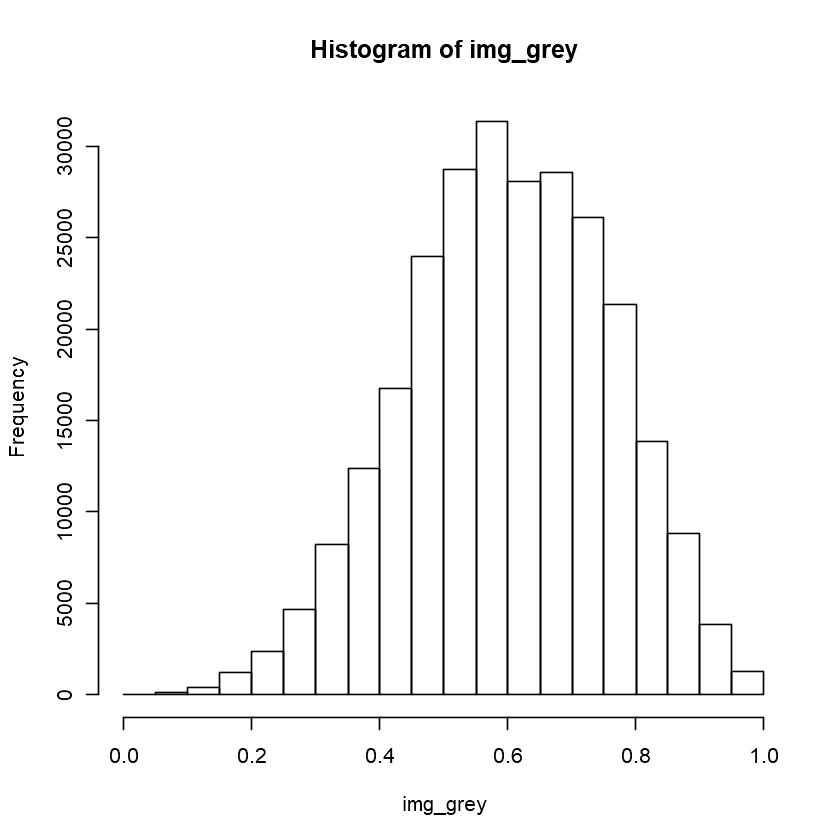

In [77]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric8_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

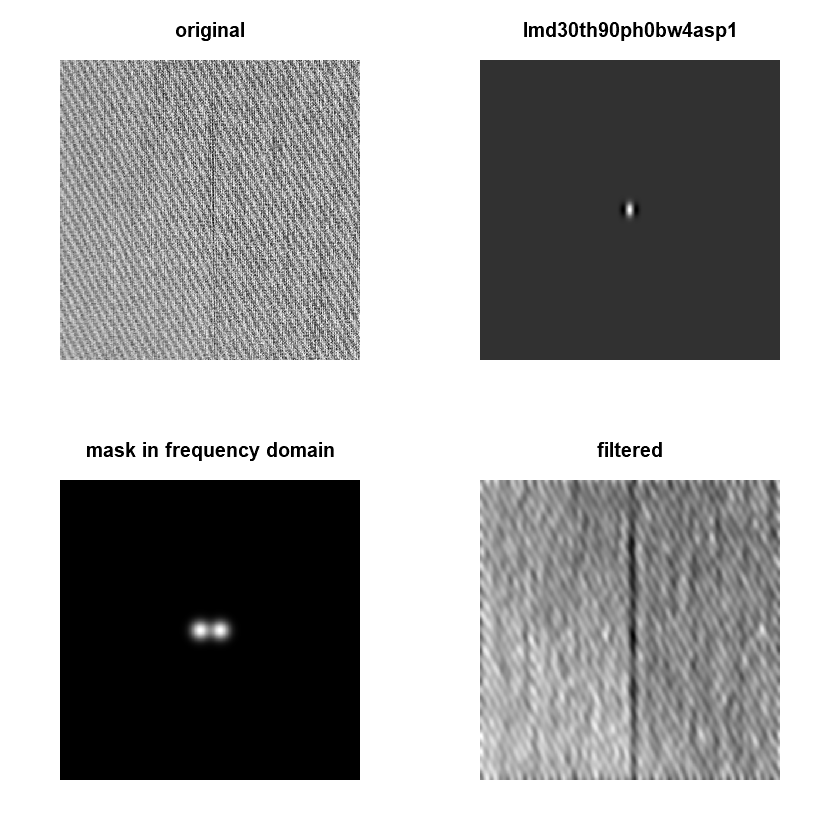

In [78]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [79]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 16204056 16333981 16471570 16616373 16767114 ...


In [80]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [81]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

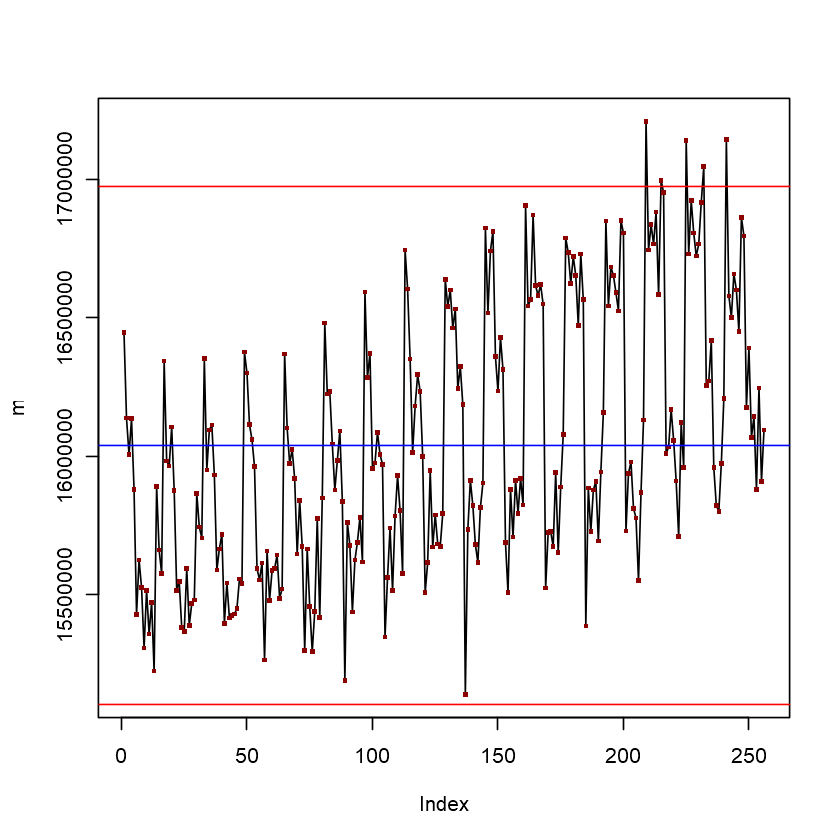

In [82]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [83]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 209 215 225 232 241

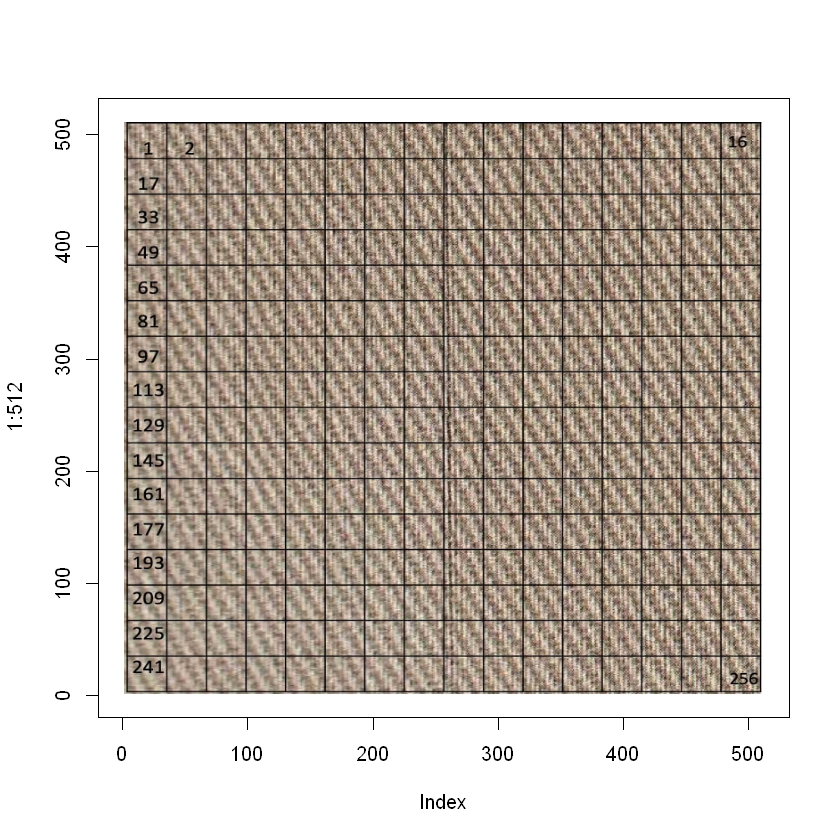

In [12]:
img_original8<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid8.jpg")
plot(1:512, type='n')
rasterImage(img_original8, 1, 1, 512, 512)

### B.5. Fabric9

 num [1:512, 1:512] 0.502 0.561 0.714 0.714 0.71 ...


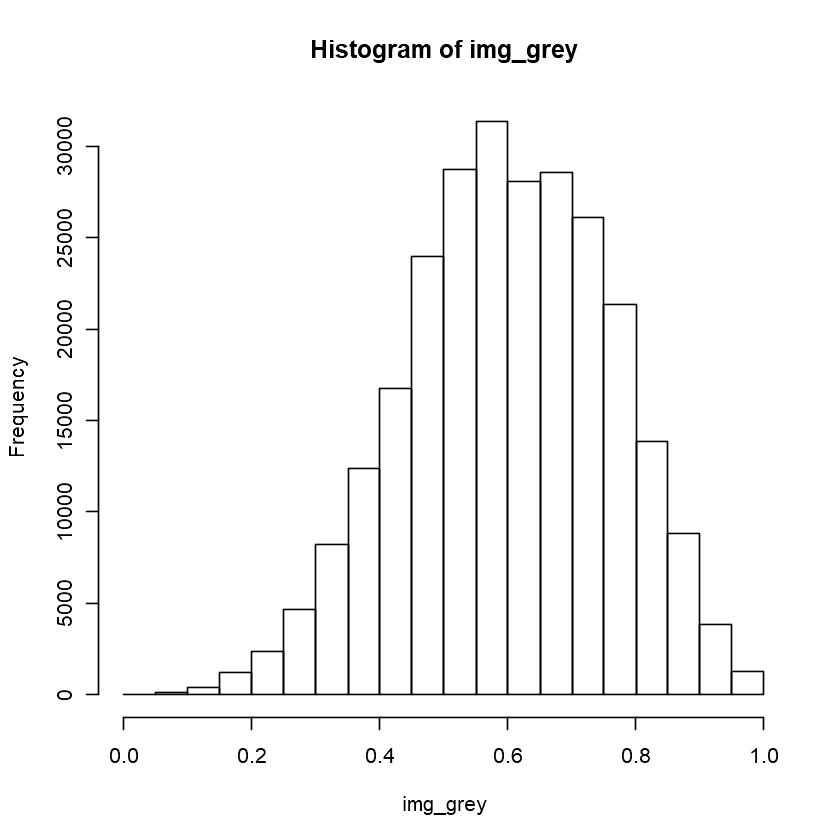

In [84]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric9_.jpg")
hist(img_grey)
str(img_grey)

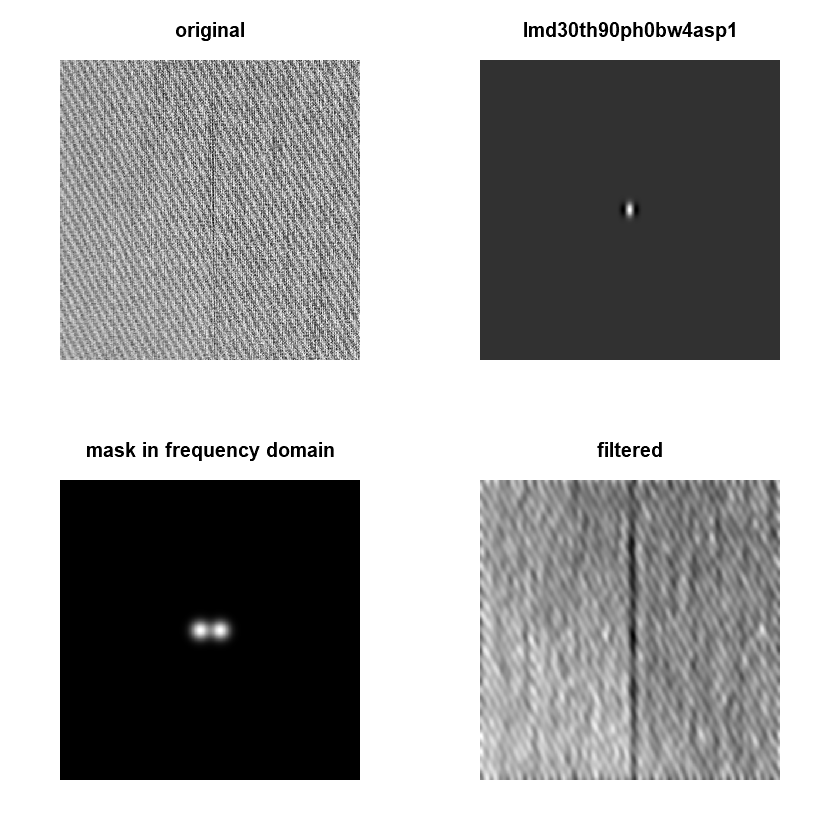

In [85]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [86]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 16204056 16333981 16471570 16616373 16767114 ...


In [87]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [88]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

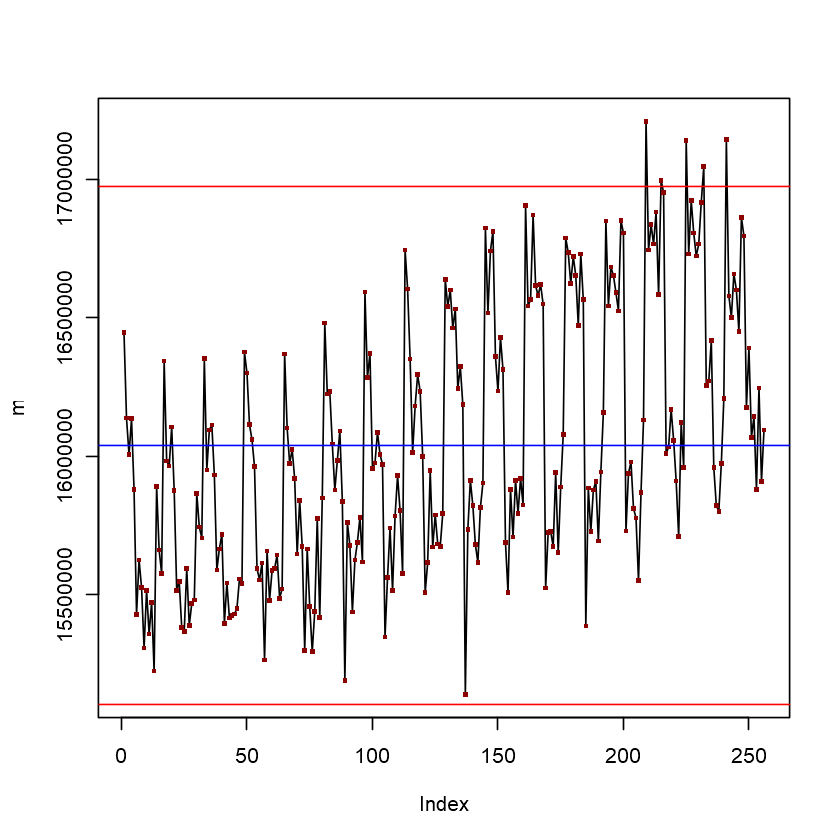

In [89]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [90]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 209 215 225 232 241

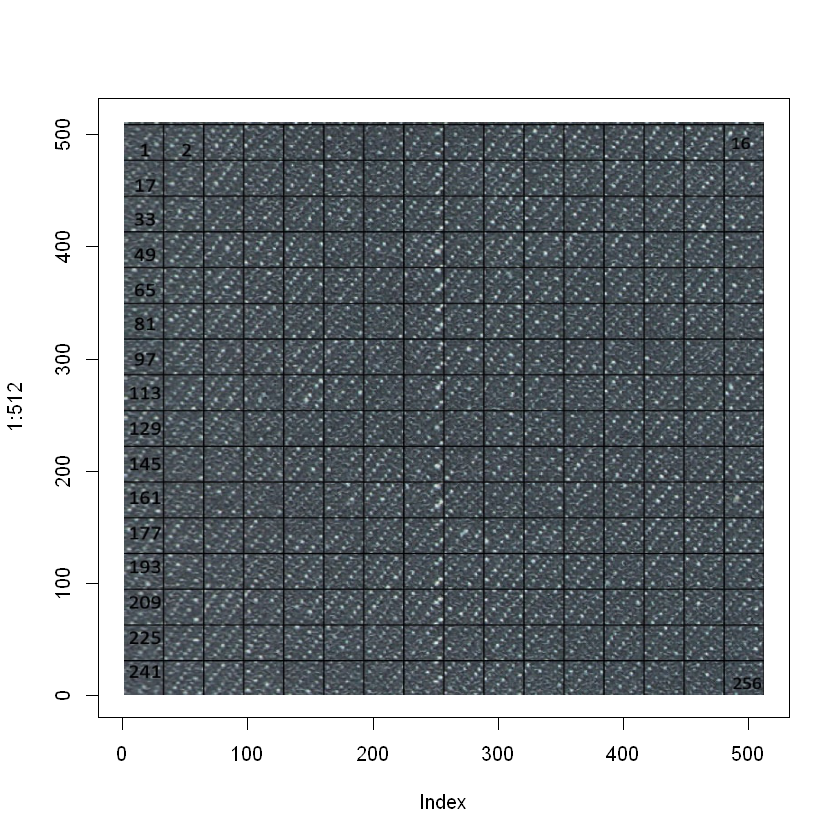

In [13]:
img_original9<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid9.jpg")
plot(1:512, type='n')
rasterImage(img_original9, 1, 1, 512, 512)

### B.6. Fabric10

 num [1:512, 1:512] 0.502 0.561 0.714 0.714 0.71 ...


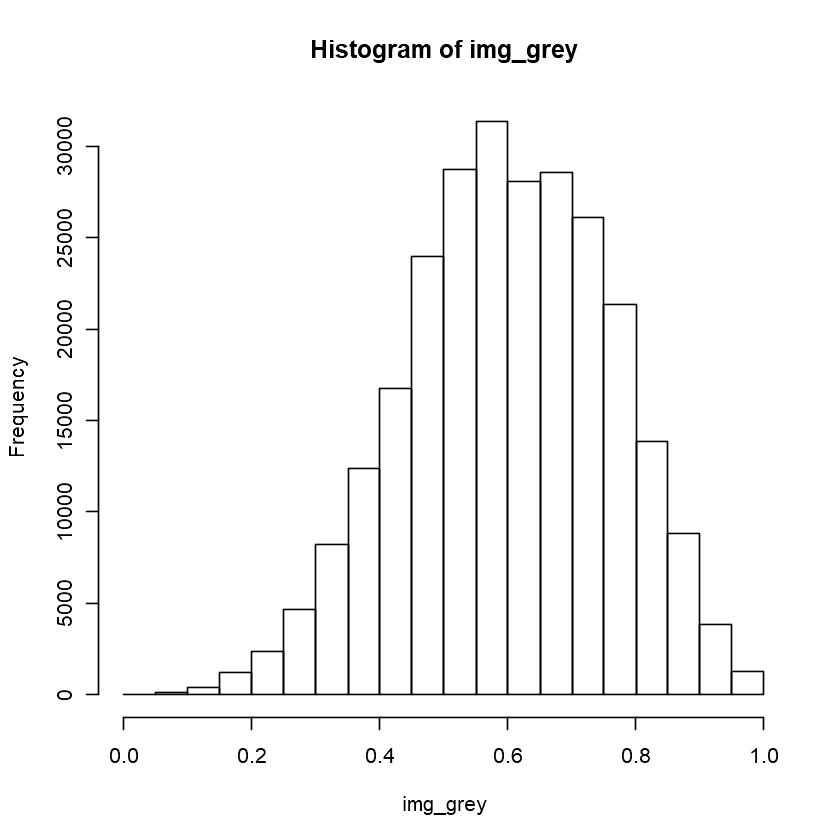

In [91]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric10_.jpg")
hist(img_grey)
str(img_grey)

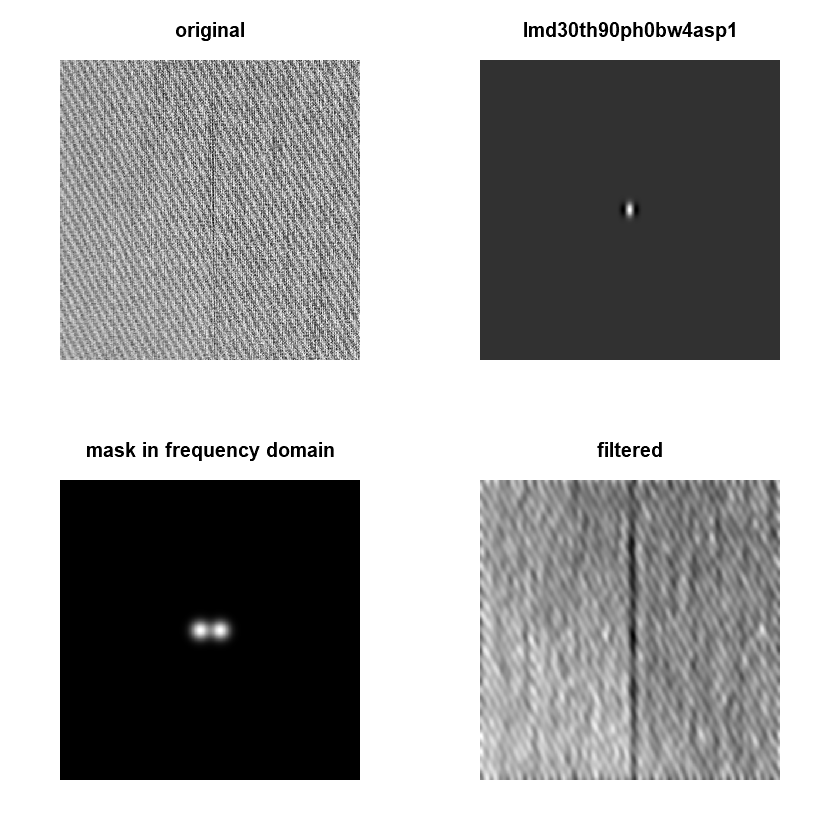

In [92]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [93]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 16204056 16333981 16471570 16616373 16767114 ...


In [94]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [96]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

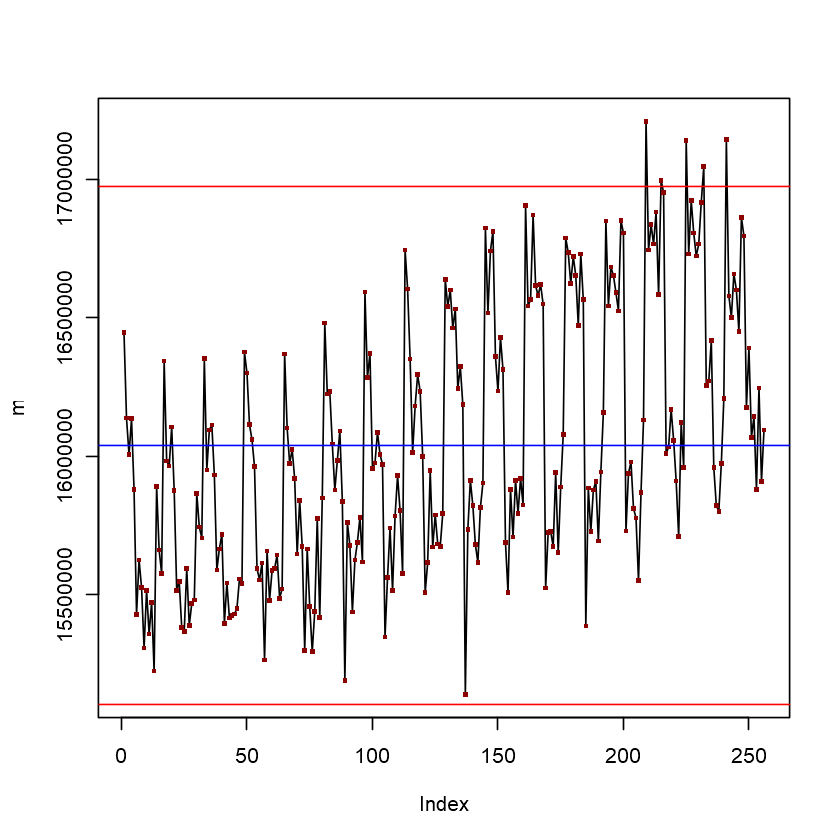

In [97]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [98]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1] 209 215 225 232 241

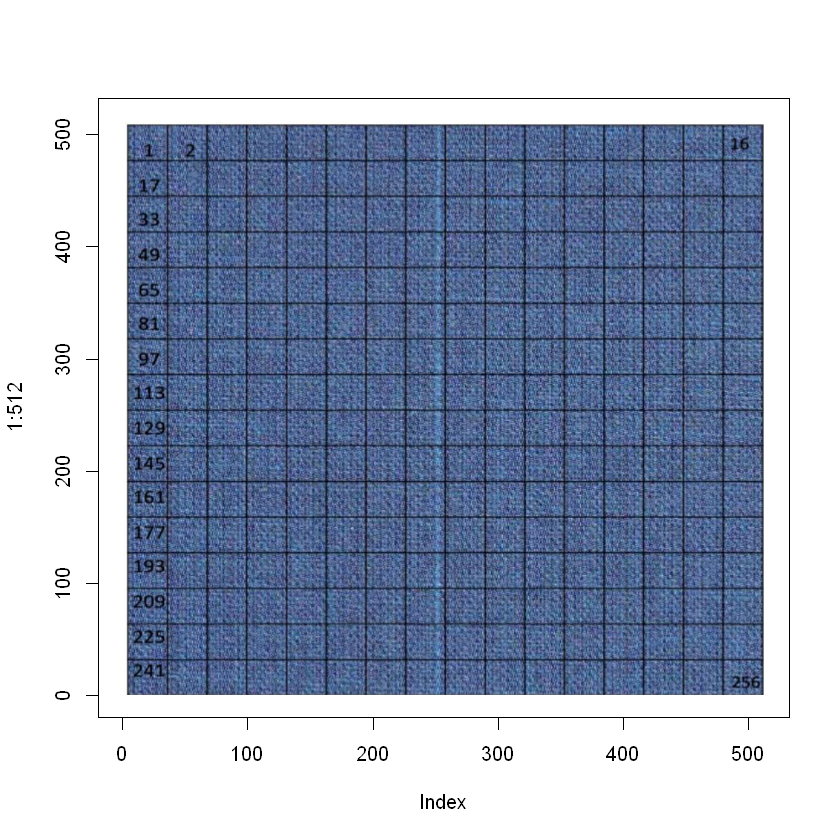

In [14]:
img_original10<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid10.jpg")
plot(1:512, type='n')
rasterImage(img_original10, 1, 1, 512, 512)

### B.7. Fabric15

 num [1:512, 1:512] 0.553 0.549 0.561 0.537 0.486 ...


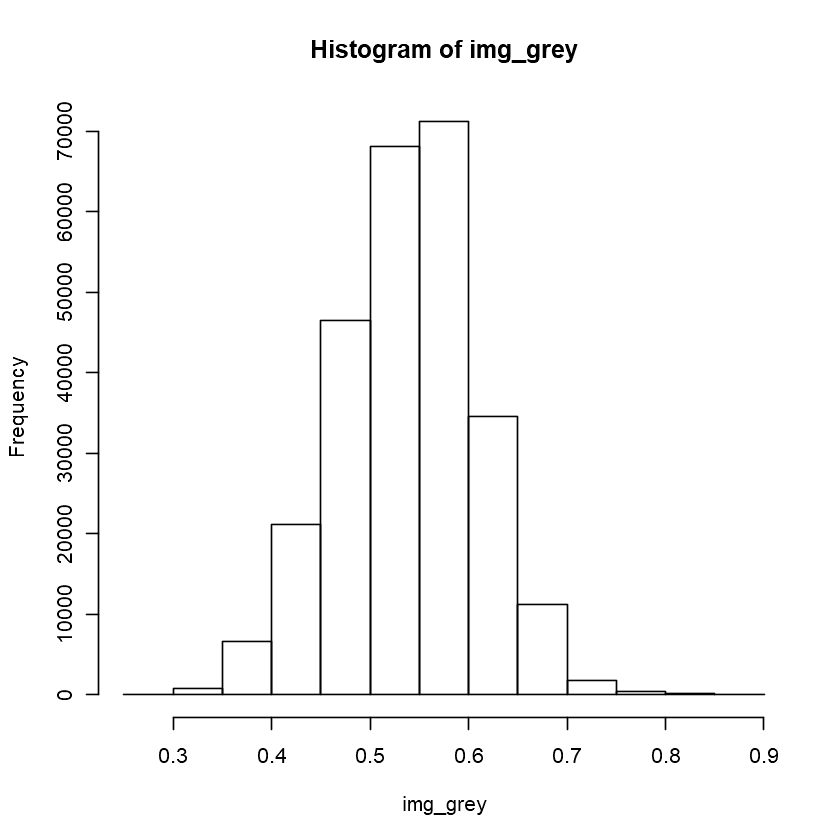

In [99]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric15_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

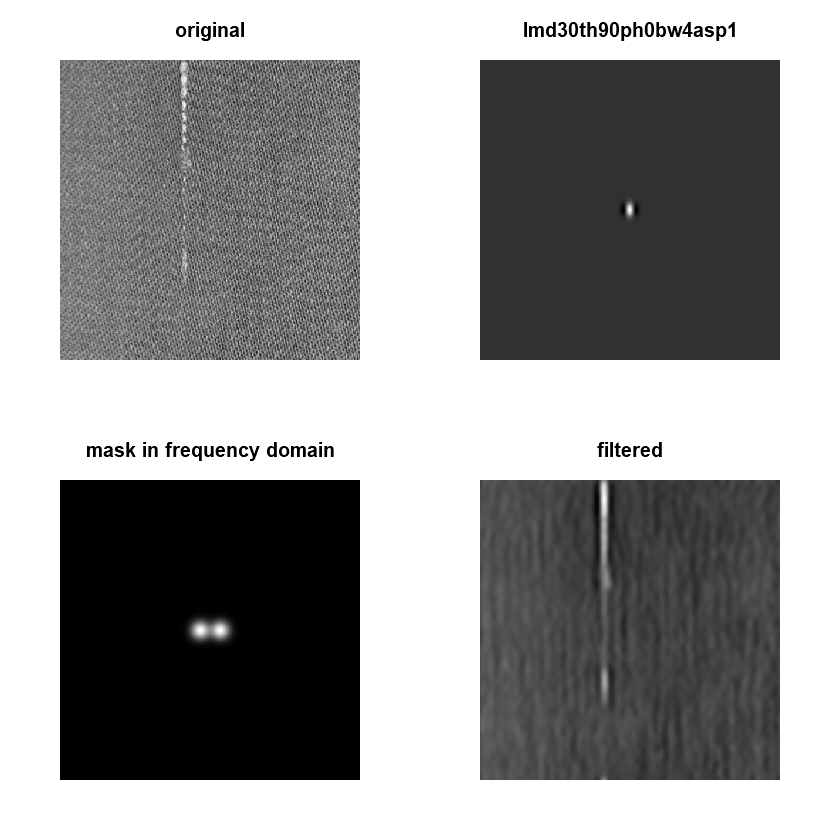

In [100]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [101]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 14061510 14041100 14026318 14017505 14014860 ...


In [102]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [103]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

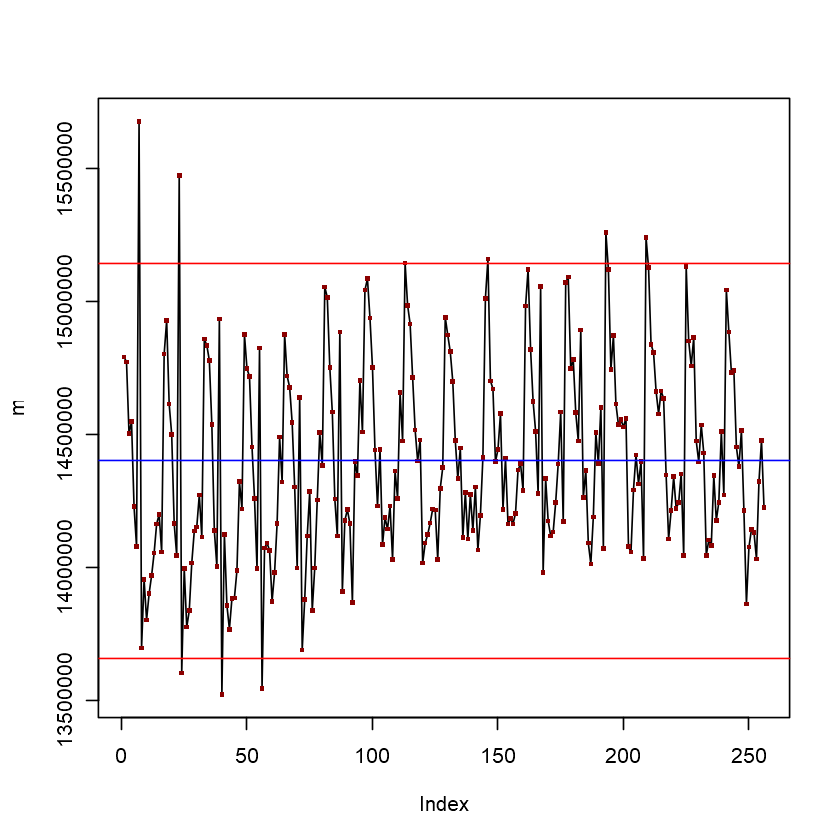

In [104]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [105]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]   7  23  24  40  56 113 146 193 209

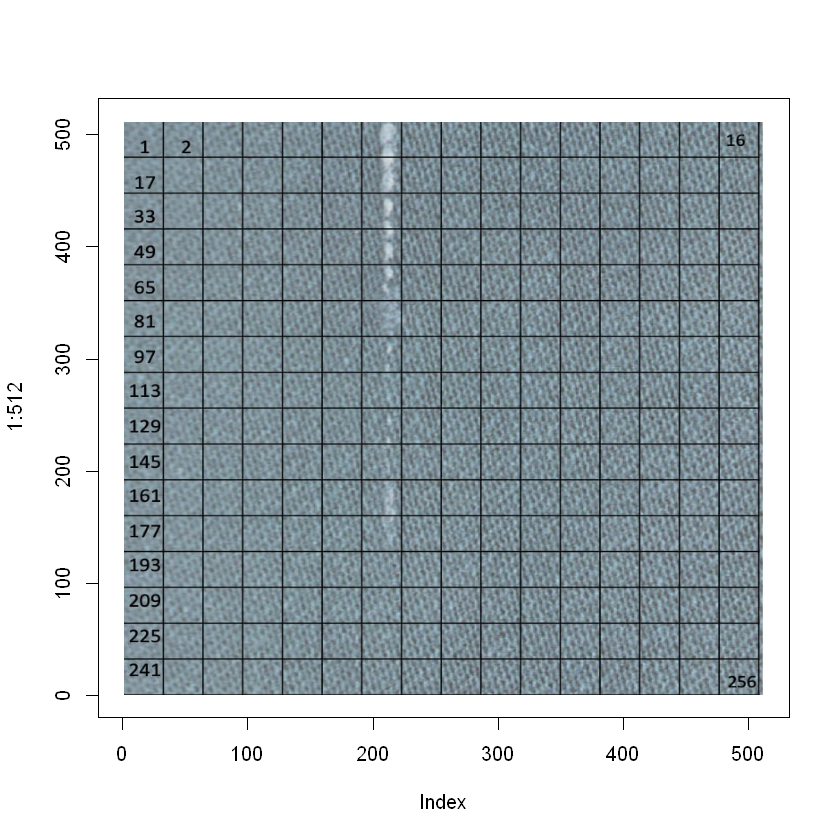

In [15]:
img_original15<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid15.jpg")
plot(1:512, type='n')
rasterImage(img_original15, 1, 1, 512, 512)

### B.8. Fabric16

 num [1:512, 1:512] 0.843 0.863 0.91 0.761 0.737 ...


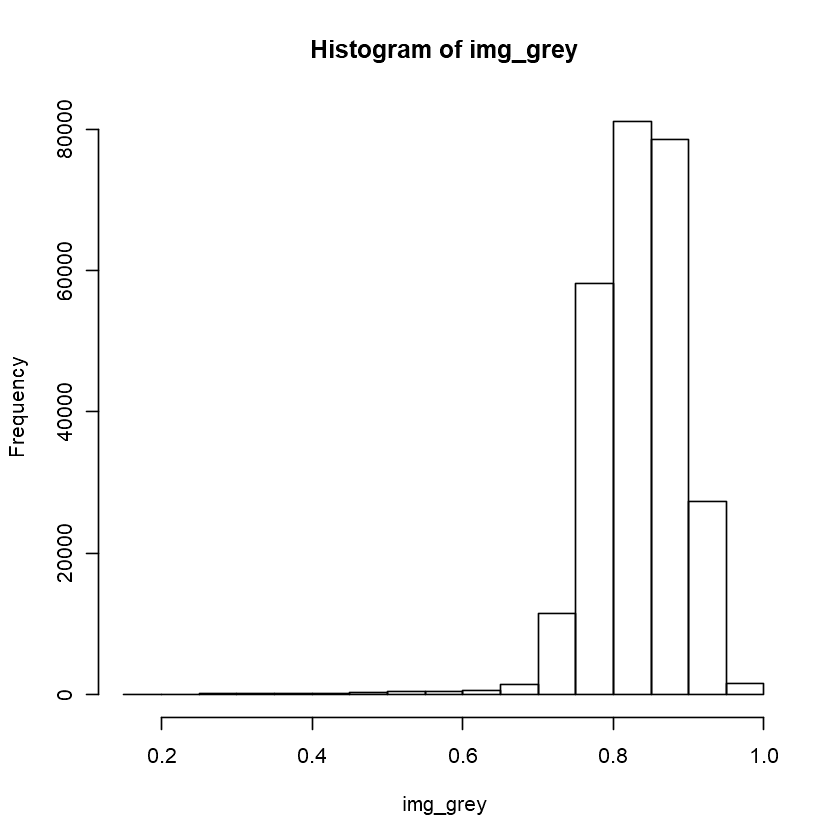

In [106]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric16_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

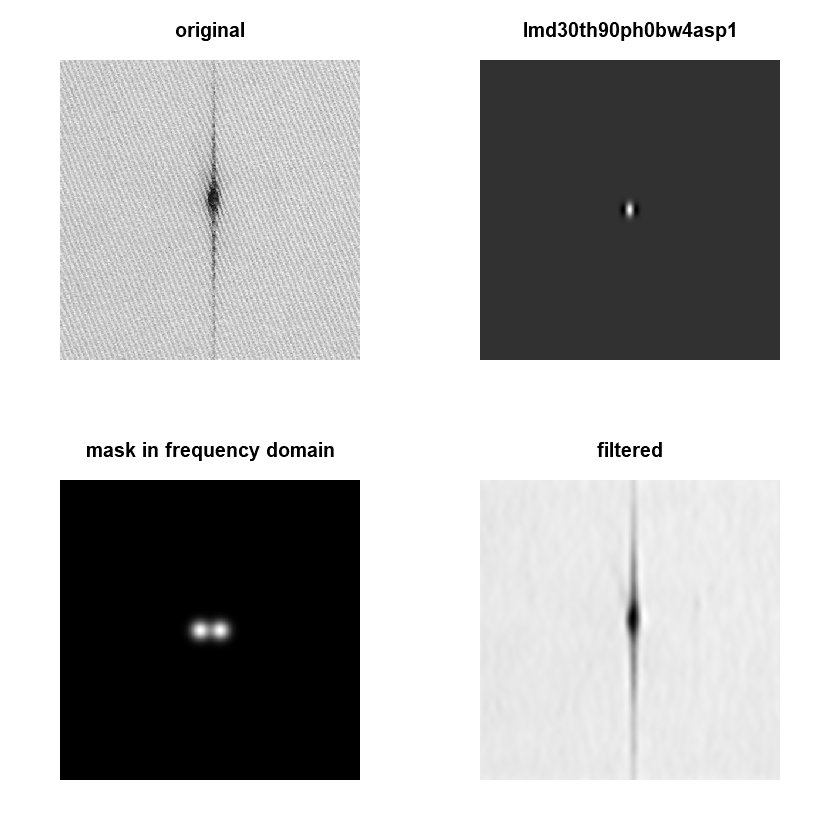

In [107]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [108]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 22348599 22335539 22320677 22304377 22287096 ...


In [109]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [110]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

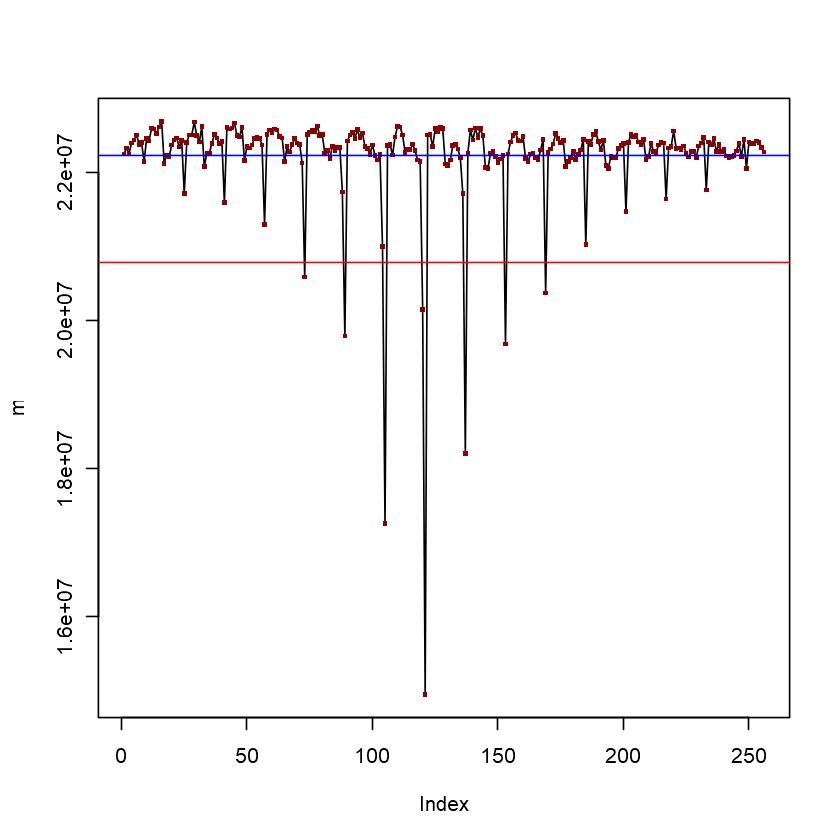

In [111]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [112]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]  73  89 105 120 121 137 153 169

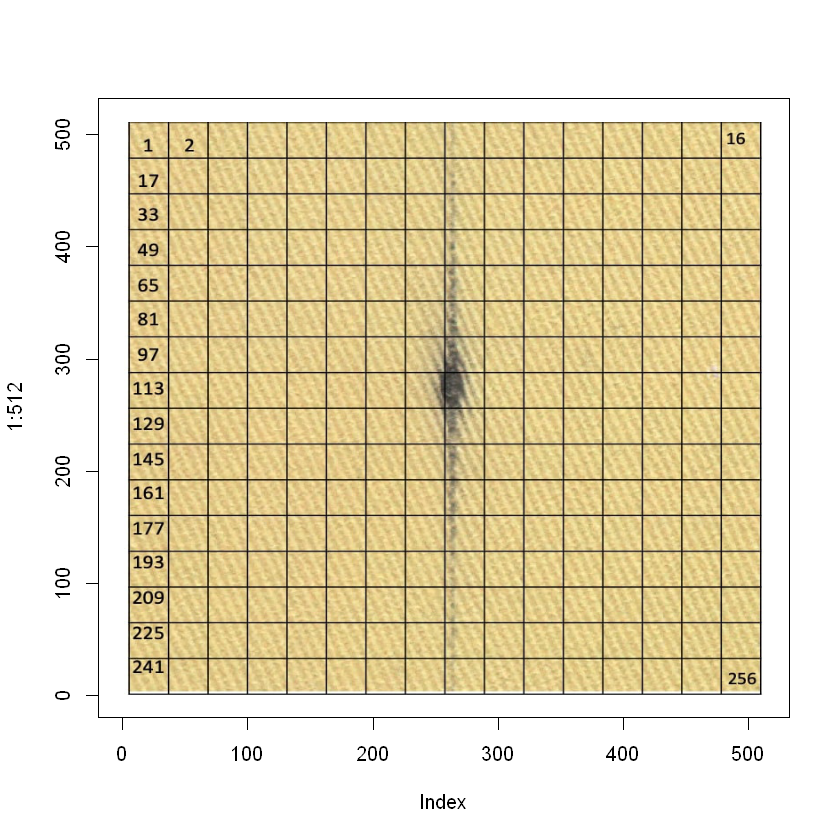

In [16]:
img_original16<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid16.jpg")
plot(1:512, type='n')
rasterImage(img_original16, 1, 1, 512, 512)

### B.9. Fabric17

 num [1:512, 1:512] 0.518 0.275 0.18 0.22 0.275 ...


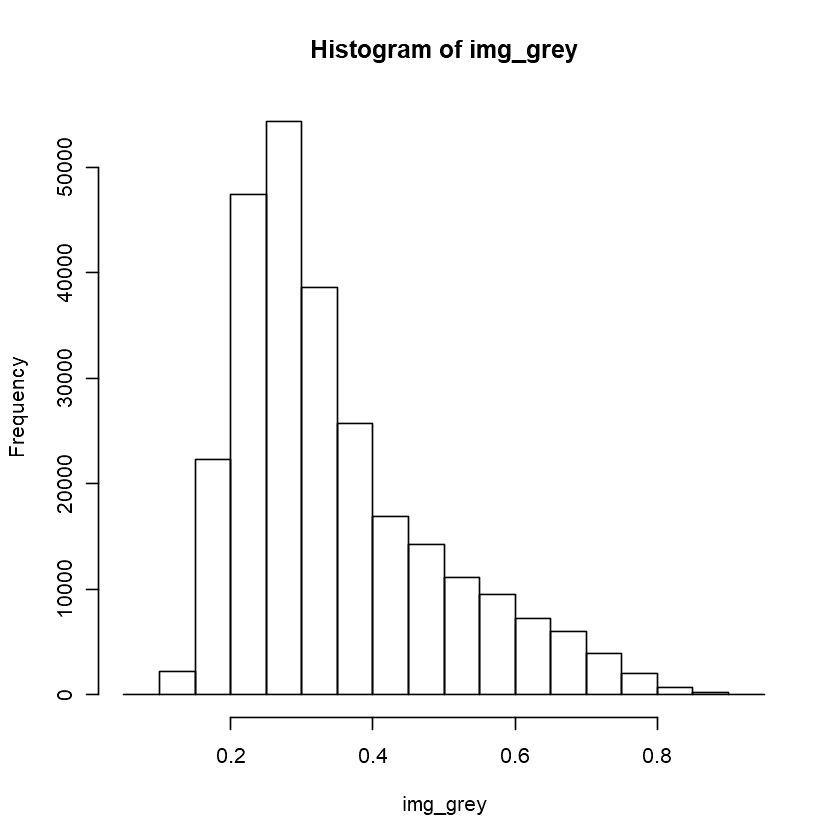

In [113]:
img<-readJPEG("C:/Users/Asus/Desktop/duygu ie/423/project part 3/images/bw/vertical/Fabric17_.jpg")
img_grey<-img[,,1]
hist(img_grey)
str(img_grey)

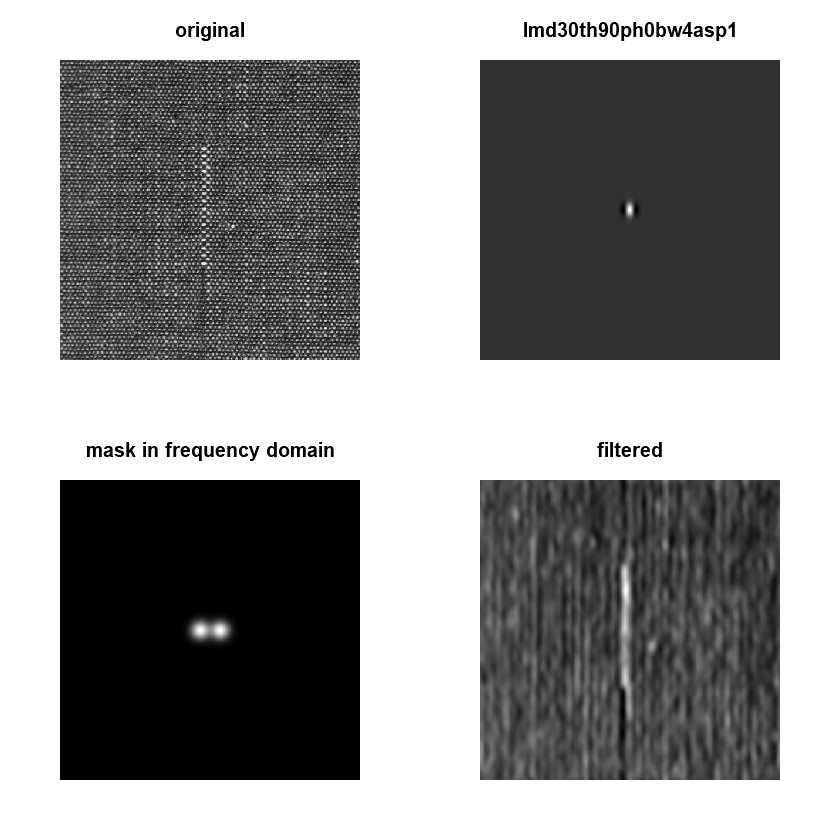

In [114]:
test<-gabor.filter(img_grey,30,90,4,0,1,TRUE)

In [115]:
str(test$filtered_img)
newimage<-test$filtered_img

 num [1:512, 1:512] 9013424 8992562 8975845 8964183 8958317 ...


In [116]:
m<-rep(NA)
s<-rep(NA)
for(i in 1:16){
  for(j in 1:16){
    m[(i-1)*16+j]=mean(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)]) 
    s[(i-1)*16+j]<-sd(newimage[(32*(i-1)+1):(32*(i-1)+32),(32*(j-1)+1):(32*(j-1)+32)])
  }
}

In [117]:
CL<-mean(m)
UCL<-CL+2*sd(m)
LCL<-CL-2*sd(m)

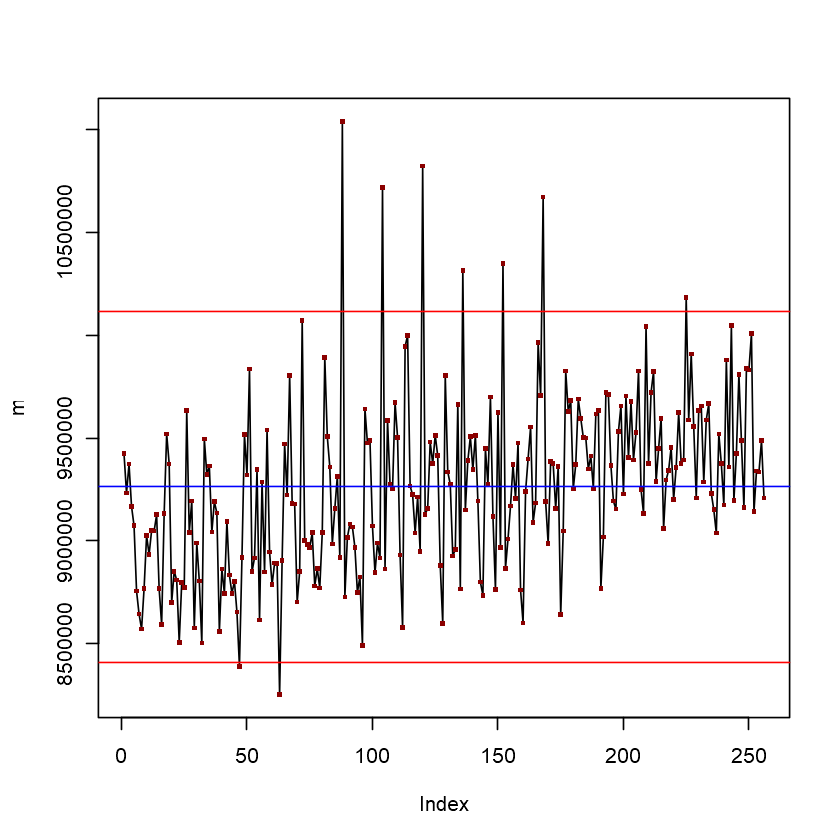

In [118]:
plot(m, type="l")
points(m, pch=".", col="darkred", cex=3, type = "p")
abline(CL,0, col="blue")
abline(UCL,0, col="red")
abline(LCL,0, col="red")

In [119]:
out_of_control<-rep(0)
k<-1
for(i in 1:256){
if(m[i]>UCL|m[i]<LCL){
  out_of_control[k]=i
  k<-k+1
  }
}
out_of_control

[1]  47  63  88 104 120 136 152 168 225

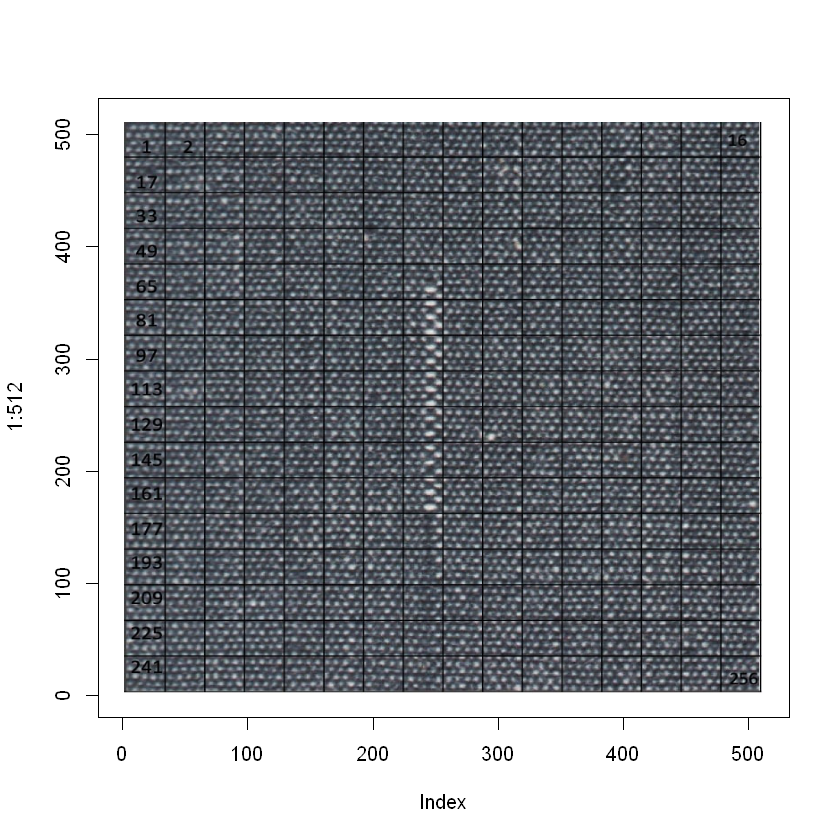

In [17]:
img_original17<-readJPEG("C:/Users/ipeku/Desktop/IE 423/IE423 Project Part 3/Grid images/grid17.jpg")
plot(1:512, type='n')
rasterImage(img_original17, 1, 1, 512, 512)

## The rest of the project continues in IE423 Project Part 3-2 due to Github document size limitation.